# Juypter Notebook for python sentiment analysis Bradford City of Culture 2025
## Introduction
This notebook aims to perform sentiment analysis, emotion analysis and topic modeling on social media data to gain insights into public opinions. The analysis is particularly focused on understanding sentiments and topics that could help the Bradford City of Culture 2025 team make data-driven decisions for community engagement.


# Import Necessary Libraries

In [1]:
import pandas as pd
import numpy as np
import re
import string
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Visualization Libraries
import plotly.express as px
import plotly.graph_objects as go
import matplotlib.pyplot as plt

# WordCloud and NLP Libraries
from wordcloud import WordCloud
from collections import Counter

# Gensim for Topic Modeling
import gensim
from gensim import corpora

# Transformers and PyTorch for BERT models
import torch
import torch.nn as nn
import torch.optim as optim
from transformers import BertTokenizer, BertModel, RobertaTokenizer, RobertaForSequenceClassification, DistilBertTokenizer, DistilBertForSequenceClassification
from transformers import BertForSequenceClassification
from torch.utils.data import DataLoader, TensorDataset, RandomSampler, SequentialSampler

# TensorFlow and Keras
import tensorflow as tf
from tensorflow.keras.preprocessing.sequence import pad_sequences

# Scikit-learn Libraries
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import classification_report, confusion_matrix

# Lime for Explainable AI
from lime.lime_text import LimeTextExplainer

# BERTViz for Attention Visualization
from bertviz import head_view


# Import Dataset
## Data Loading and Exploration
In this section, we load the data and perform an initial exploration to understand its structure, identify missing values, and get a general sense of the information it contains. This is crucial to ensure the data is suitable for further analysis.


In [37]:
# Load the data
file_path = 'C:/Users/ASUS/dataset_easy-twitter-search-scraper_2024-06-21_21-49-59-220 (1).xlsx'
sentiment_df = pd.read_excel(file_path)

# Preview the data
print(sentiment_df.head())

                                                text
0  I’ve booked tickets for 9 @BradfordLitFest eve...
1  SHOES NEWS: Check out Wayne's UnCovered interv...
2  Shoes News: Hey American friends...check us ou...
3  On Friday 20th September we are holding 'An Ev...
4  Creative Earth Eco Fest \nProduced by Photo hu...


In [39]:
# Inspect the DataFrame
print(sentiment_df.columns)
print(sentiment_df.head())

Index(['text'], dtype='object')
                                                text
0  I’ve booked tickets for 9 @BradfordLitFest eve...
1  SHOES NEWS: Check out Wayne's UnCovered interv...
2  Shoes News: Hey American friends...check us ou...
3  On Friday 20th September we are holding 'An Ev...
4  Creative Earth Eco Fest \nProduced by Photo hu...


In [41]:
sentiment_df.dtypes

text    object
dtype: object

In [43]:
sentiment_df

,text
0,I’ve booked tickets for 9 @BradfordLitFest eve...
1,SHOES NEWS: Check out Wayne's UnCovered interv...
2,Shoes News: Hey American friends...check us ou...
3,On Friday 20th September we are holding 'An Ev...
4,Creative Earth Eco Fest \nProduced by Photo hu...
...,...
4236,U sound racist
4237,Great to have the perspective from both sides ...
4238,You forget that some of those areas used to be...
4239,I'm not to blame for the areas being shitholes...


# Data Preprocessing 
This section covers data cleaning and preprocessing steps, including text cleaning, tokenization, removal of stop words, and preparing the text data for analysis. These steps help standardize the text data, making it ready for sentiment analysis and topic modeling.


In [45]:
# Download NLTK resources
nltk.download('punkt')
nltk.download('stopwords')

# Define the stop words
stop_words = set(stopwords.words('english'))
stop_words.update(string.punctuation)  # Add punctuation to the stop words list

# Function to clean text
def clean_text(text):
    if not isinstance(text, str):
        return ""
    
    # Convert text to lowercase
    text = text.lower()
    
    # Remove URLs
    text = re.sub(r'http\S+|www\S+|https\S+', '', text, flags=re.MULTILINE)
    
    # Remove user mentions
    text = re.sub(r'@\w+', '', text)
    
    # Remove hashtags
    text = re.sub(r'#\w+', '', text)
    
    # Remove special characters and numbers
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    
    # Remove extra spaces
    text = text.strip()
    text = re.sub(r'\s+', ' ', text)
    
    return text

# Function to preprocess text (tokenization and stop word removal)
def preprocess_text(text):
    # Clean the text
    text = clean_text(text)
    # Tokenize the text
    tokens = word_tokenize(text)
    # Remove stop words and punctuation
    tokens = [word for word in tokens if word.lower() not in stop_words]
    return ' '.join(tokens)

sentiment_df['text'] = sentiment_df['text'].apply(preprocess_text)

# Display the first few rows of the preprocessed dataframe
print(sentiment_df.head())

sentiment_df.to_excel('preprocessed_dataset_fourth.xlsx', index=False)
print('Preprocessed dataset saved to preprocessed_dataset.xlsx')


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\ASUS\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\ASUS\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


                                                text
0  ive booked tickets events explore words discov...
1  shoes news check waynes uncovered interview ar...
2  shoes news hey american friendscheck us amazin...
3  friday th september holding evening philippas ...
4  creative earth eco fest produced photo hub nor...
Preprocessed dataset saved to preprocessed_dataset.xlsx


In [47]:
sentiment_df.isnull().sum()

text    0
dtype: int64

In [49]:
sentiment_df.dropna()

,text
0,ive booked tickets events explore words discov...
1,shoes news check waynes uncovered interview ar...
2,shoes news hey american friendscheck us amazin...
3,friday th september holding evening philippas ...
4,creative earth eco fest produced photo hub nor...
...,...
4236,u sound racist
4237,great perspective sides shows much common grou...
4238,forget areas used nice
4239,im blame areas shitholes


In [51]:
nltk.download('vader_lexicon')

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     C:\Users\ASUS\AppData\Roaming\nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


True

# Vader Sentiment Analyzer

In [53]:
# Initialize VADER sentiment analyzer
sid = SentimentIntensityAnalyzer()

# Function to get sentiment scores and classification
def get_sentiment_scores(text):
    scores = sid.polarity_scores(text)
    # Classify sentiment based on compound score
    if scores['compound'] >= 0.05:
        sentiment = 1  # Positive
    elif scores['compound'] <= -0.05:
        sentiment = -1  # Negative
    else:
        sentiment = 0  # Neutral
    scores['sentiment'] = sentiment
    return scores

# Apply the sentiment analysis to the 'text' column
sentiment_scores = sentiment_df['text'].apply(get_sentiment_scores)
sentiment_scores_df = pd.DataFrame(list(sentiment_scores))

# Combine the sentiment scores with the original DataFrame
sentiment_df = pd.concat([sentiment_df, sentiment_scores_df], axis=1)

# Inspect the DataFrame with the new sentiment columns
print(sentiment_df.head())

# Export the DataFrame with sentiments to a CSV file
cleaned_file_path = 'C:/Users/ASUS/preprocessed_sentiments_with_labels_fifth_earlystoppingg3.csv'
sentiment_df.to_csv(cleaned_file_path, index=False)
print(f"Cleaned data with sentiment labels exported to {cleaned_file_path}")


                                                text  neg    neu    pos  \
0  ive booked tickets events explore words discov...  0.0  1.000  0.000   
1  shoes news check waynes uncovered interview ar...  0.0  1.000  0.000   
2  shoes news hey american friendscheck us amazin...  0.0  0.774  0.226   
3  friday th september holding evening philippas ...  0.0  0.633  0.367   
4  creative earth eco fest produced photo hub nor...  0.0  0.585  0.415   

   compound  sentiment  
0    0.0000          0  
1    0.0000          0  
2    0.5859          1  
3    0.8271          1  
4    0.7269          1  
Cleaned data with sentiment labels exported to C:/Users/ASUS/preprocessed_sentiments_with_labels_fifth_earlystoppingg3.csv


In [55]:
sentiment_df

,text,neg,neu,pos,compound,sentiment
0,ive booked tickets events explore words discov...,0.000,1.000,0.000,0.0000,0
1,shoes news check waynes uncovered interview ar...,0.000,1.000,0.000,0.0000,0
2,shoes news hey american friendscheck us amazin...,0.000,0.774,0.226,0.5859,1
3,friday th september holding evening philippas ...,0.000,0.633,0.367,0.8271,1
4,creative earth eco fest produced photo hub nor...,0.000,0.585,0.415,0.7269,1
...,...,...,...,...,...,...
4236,u sound racist,0.800,0.200,0.000,-0.6124,-1
4237,great perspective sides shows much common grou...,0.233,0.648,0.119,-0.7783,-1
4238,forget areas used nice,0.284,0.299,0.418,0.2263,1
4239,im blame areas shitholes,0.444,0.556,0.000,-0.3400,-1


In [57]:
sentiment_df.dtypes

text          object
neg          float64
neu          float64
pos          float64
compound     float64
sentiment      int64
dtype: object

In [59]:
sentiment_df.drop(columns = ["neg","pos","neu","compound"], inplace=True)

In [61]:
sentiment_df

,text,sentiment
0,ive booked tickets events explore words discov...,0
1,shoes news check waynes uncovered interview ar...,0
2,shoes news hey american friendscheck us amazin...,1
3,friday th september holding evening philippas ...,1
4,creative earth eco fest produced photo hub nor...,1
...,...,...
4236,u sound racist,-1
4237,great perspective sides shows much common grou...,-1
4238,forget areas used nice,1
4239,im blame areas shitholes,-1


In [63]:
sentiment_df

,text,sentiment
0,ive booked tickets events explore words discov...,0
1,shoes news check waynes uncovered interview ar...,0
2,shoes news hey american friendscheck us amazin...,1
3,friday th september holding evening philippas ...,1
4,creative earth eco fest produced photo hub nor...,1
...,...,...
4236,u sound racist,-1
4237,great perspective sides shows much common grou...,-1
4238,forget areas used nice,1
4239,im blame areas shitholes,-1


# Topic Modelling with BERT

In [65]:
import pandas as pd
from transformers import BertTokenizer, BertForSequenceClassification, pipeline

# Initialize the tokenizer and model for BERT fine-tuned on emotions
tokenizer = BertTokenizer.from_pretrained("nateraw/bert-base-uncased-emotion")
model = BertForSequenceClassification.from_pretrained("nateraw/bert-base-uncased-emotion")

# Initialize the pipeline
classifier = pipeline("text-classification", model=model, tokenizer=tokenizer, return_all_scores=True)

sentiment_df['emotions'] = sentiment_df['text'].apply(lambda x: classifier(x))

# Save the processed dataset
output_file_path = "C:/Users/ASUS/processed_emotions_dataset_bert_three.csv"
sentiment_df.to_csv(output_file_path, index=False)

print(f"Processed dataset saved to {output_file_path}")


C:\Users\ASUS\anaconda3\Lib\site-packages\transformers\tokenization_utils_base.py:1601: FutureWarning:

`clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884

Hardware accelerator e.g. GPU is available in the environment, but no `device` argument is passed to the `Pipeline` object. Model will be on CPU.
C:\Users\ASUS\anaconda3\Lib\site-packages\transformers\pipelines\text_classification.py:104: UserWarning:

`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.



Processed dataset saved to C:/Users/ASUS/processed_emotions_dataset_bert_three.csv


In [71]:
# Save the processed dataset
output_file_path_ = "C:/Users/ASUS/processed_emotions_dataset_bert_emotions_three.csv"
sentiment_df.to_csv(output_file_path_, index=False)

In [67]:
sentiment_df

,text,sentiment,emotions
0,ive booked tickets events explore words discov...,0,"[[{'label': 'sadness', 'score': 0.037367224693..."
1,shoes news check waynes uncovered interview ar...,0,"[[{'label': 'sadness', 'score': 0.048308305442..."
2,shoes news hey american friendscheck us amazin...,1,"[[{'label': 'sadness', 'score': 0.003428490599..."
3,friday th september holding evening philippas ...,1,"[[{'label': 'sadness', 'score': 0.000861815060..."
4,creative earth eco fest produced photo hub nor...,1,"[[{'label': 'sadness', 'score': 0.006043191533..."
...,...,...,...
4236,u sound racist,-1,"[[{'label': 'sadness', 'score': 0.009317594580..."
4237,great perspective sides shows much common grou...,-1,"[[{'label': 'sadness', 'score': 0.001343587180..."
4238,forget areas used nice,1,"[[{'label': 'sadness', 'score': 0.063617847859..."
4239,im blame areas shitholes,-1,"[[{'label': 'sadness', 'score': 0.405638009309..."


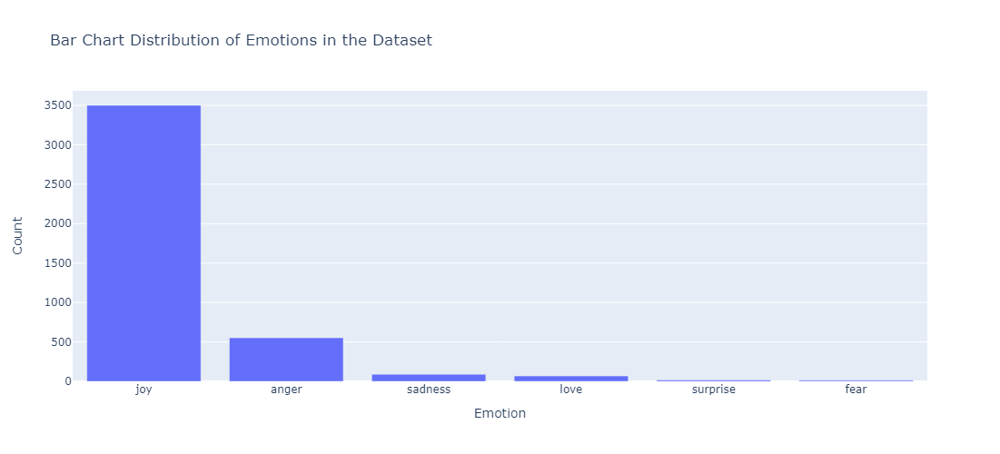

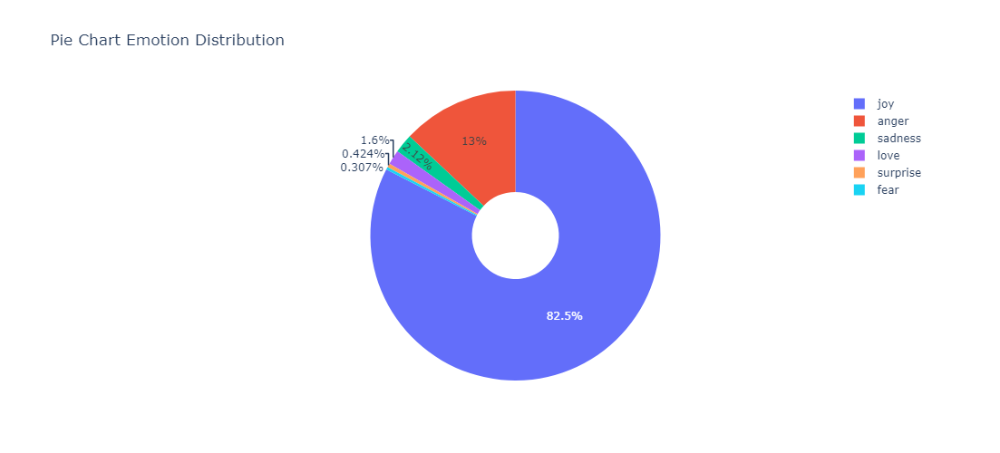

In [79]:
# Function to extract the top emotion from the list of lists of dictionaries
def get_top_emotion(emotion_scores):
    if isinstance(emotion_scores, str):
        # Convert string representation of list of lists to an actual list
        emotion_scores = eval(emotion_scores)
    if isinstance(emotion_scores, list):
        if isinstance(emotion_scores[0], list):  # Check if it's a list of lists
            emotion_scores = emotion_scores[0]  # Access the first inner list
        top_emotion = max(emotion_scores, key=lambda x: x['score'])['label']
        return top_emotion
    else:
        raise ValueError("Unexpected format for emotion scores")

# Apply the function to extract the top emotion
sentiment_df['top_emotion'] = sentiment_df['emotions'].apply(get_top_emotion)

# Count the occurrences of each emotion
emotion_counts = sentiment_df['top_emotion'].value_counts()

# Bar Plot using Plotly
fig_bar = px.bar(
    emotion_counts,
    x=emotion_counts.index,
    y=emotion_counts.values,
    labels={'x': 'Emotion', 'y': 'Count'},
    title='Bar Chart Distribution of Emotions in the Dataset'
)
fig_bar.update_layout(xaxis_title="Emotion", yaxis_title="Count", width=800, height=500)
fig_bar.show()

# Pie Chart using Plotly
fig_pie = go.Figure(
    data=[go.Pie(labels=emotion_counts.index, values=emotion_counts.values, hole=.3)]
)
fig_pie.update_layout(title_text='Pie Chart Emotion Distribution',width=800, height=500)
fig_pie.show()

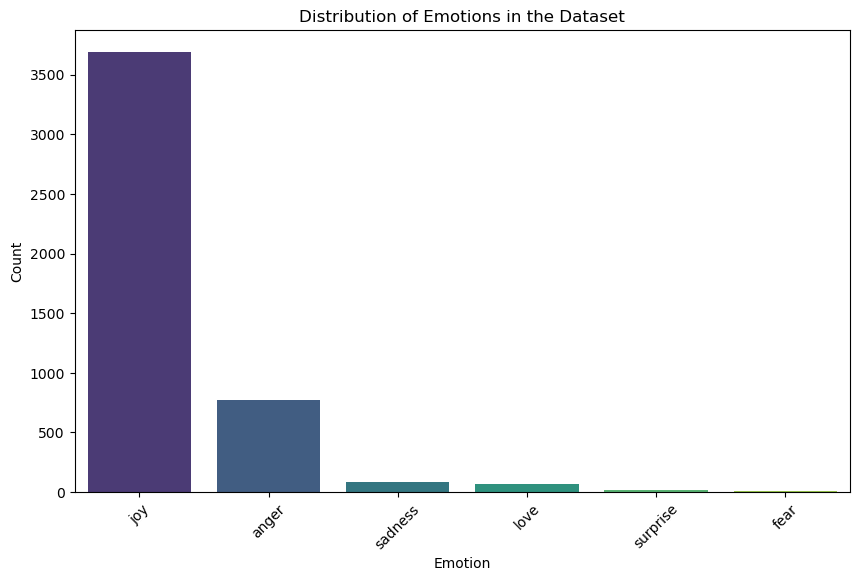

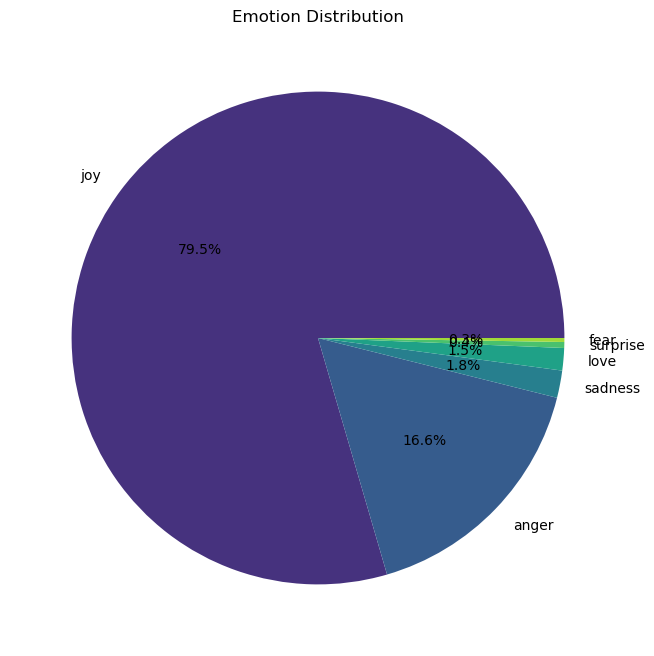

In [43]:
# Function to extract the top emotion from the list of lists of dictionaries
def get_top_emotion(emotion_scores):
    if isinstance(emotion_scores, str):
        # Convert string representation of list of lists to an actual list
        emotion_scores = eval(emotion_scores)
    if isinstance(emotion_scores, list):
        if isinstance(emotion_scores[0], list):  # Check if it's a list of lists
            emotion_scores = emotion_scores[0]  # Access the first inner list
        top_emotion = max(emotion_scores, key=lambda x: x['score'])['label']
        return top_emotion
    else:
        raise ValueError("Unexpected format for emotion scores")

# Apply the function to extract the top emotion
sentiment_df['top_emotion'] = sentiment_df['emotions'].apply(get_top_emotion)

# Count the occurrences of each emotion
emotion_counts = sentiment_df['top_emotion'].value_counts()

# Plot the distribution of emotions
plt.figure(figsize=(10, 6))
sns.barplot(x=emotion_counts.index, y=emotion_counts.values, palette='viridis')
plt.title('Distribution of Emotions in the Dataset')
plt.xlabel('Emotion')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

# Optional: Pie chart visualization
plt.figure(figsize=(8, 8))
plt.pie(emotion_counts, labels=emotion_counts.index, autopct='%1.1f%%', colors=sns.color_palette('viridis', len(emotion_counts)))
plt.title('Emotion Distribution')
plt.show()

# Topic Modelling LDA 
## Visualization of Topic Modeling Results
This section visualizes the topics identified by LDA, making it easier to interpret the results and identify the dominant themes in the dataset.


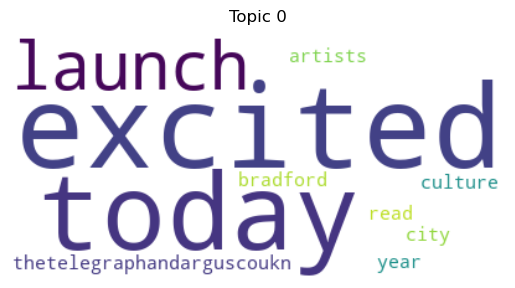

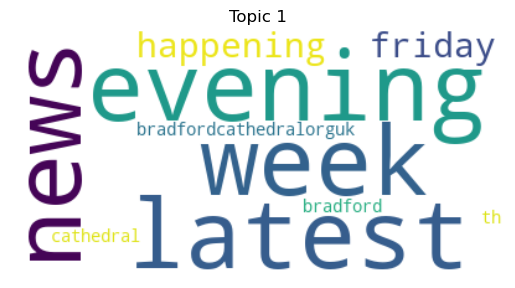

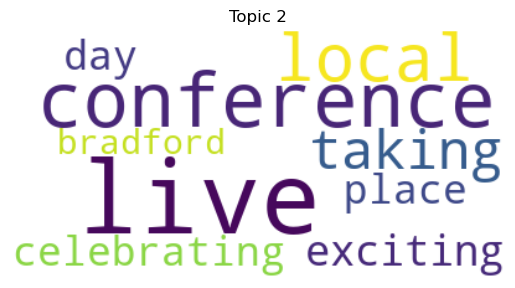

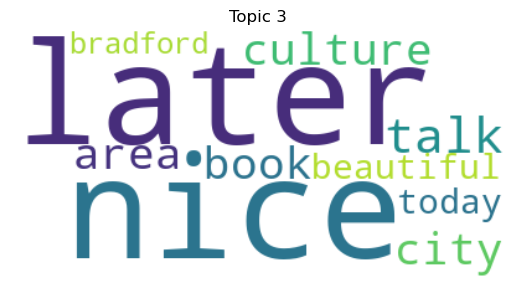

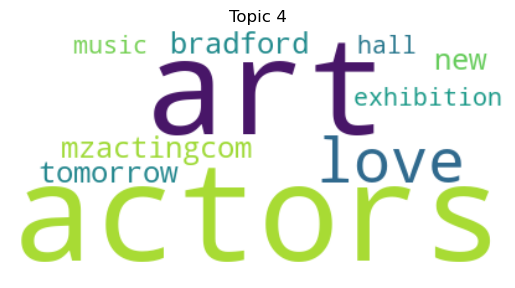

...

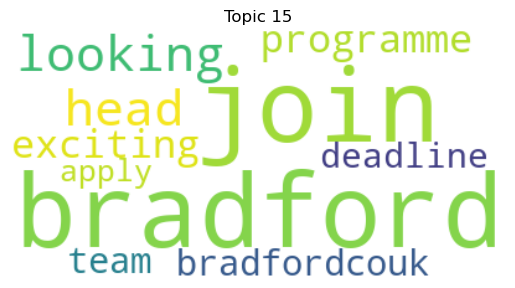

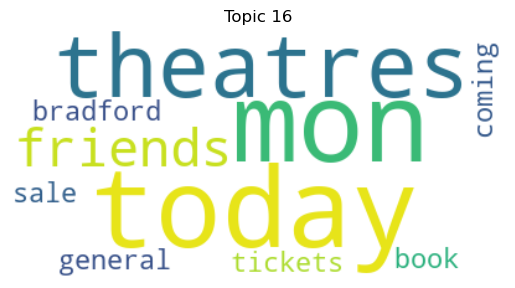

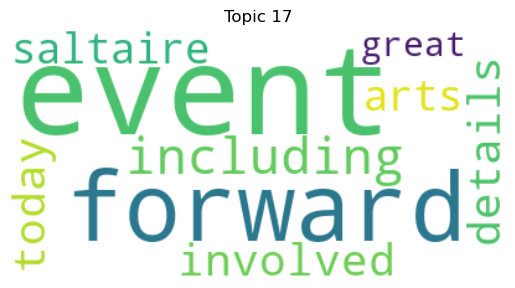

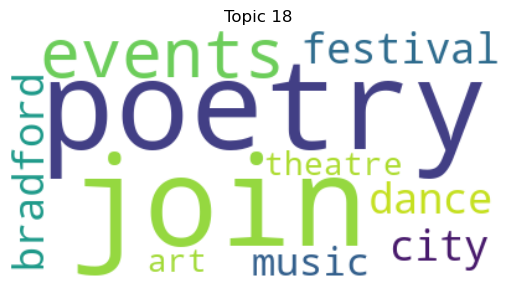

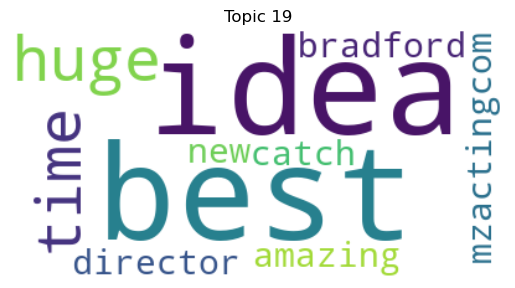

In [215]:
# Example for LDA or any other topic model
for topic_idx, topic in enumerate(lda.components_):
    wordcloud = WordCloud(background_color='white').generate(" ".join([feature_names[i] for i in topic.argsort()[-10:]]))
    plt.figure()
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.title(f"Topic {topic_idx}")
    plt.show()


In [245]:
# Step 1: Tokenize the text data
tokenized_text = [text.split() for text in sentiment_df['text']]

# Step 2: Create a dictionary representation of the documents
dictionary = corpora.Dictionary(tokenized_text)

# Step 3: Filter out extremes to remove stopwords that might still be present
dictionary.filter_extremes(no_below=5, no_above=0.5)

# Step 4: Convert the documents into Bag-of-Words format
corpus = [dictionary.doc2bow(text) for text in tokenized_text]

# Step 5: Apply LDA with more topics
lda_model = gensim.models.LdaModel(corpus, num_topics=10, id2word=dictionary, passes=15)

# Step 6: Get the top 10 topics
top_topics = lda_model.print_topics(num_words=1)

# Extracting the top 10 topic words and their frequencies
topic_words = []
for topic in top_topics:
    word = topic[1].split('"')[1]
    topic_words.append(word)

# Count occurrences of the top topic words in the dataset
word_counts = Counter([word for sublist in tokenized_text for word in sublist])

# Get the count of the top 10 topic words
top_10_topics = [(word, word_counts[word]) for word in topic_words]

# Display the top 10 topics with their counts
for i, (topic, count) in enumerate(top_10_topics, 1):
    print(f"Topic {i}: {topic}, Count: {count}")


Topic 1: life, Count: 170
Topic 2: team, Count: 150
Topic 3: sure, Count: 169
Topic 4: arts, Count: 129
Topic 5: bradford, Count: 843
Topic 6: people, Count: 360
Topic 7: history, Count: 78
Topic 8: religion, Count: 64
Topic 9: bradford, Count: 843
Topic 10: tickets, Count: 253


C:\Users\ASUS\anaconda3\Lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.

C:\Users\ASUS\anaconda3\Lib\site-packages\plotly\io\_renderers.py:395: DeprecationWarning:

distutils Version classes are deprecated. Use packaging.version instead.



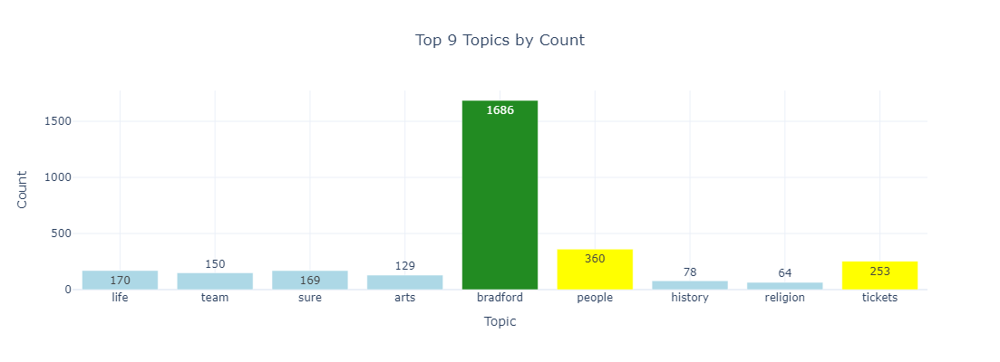

In [259]:
# Data with aggregated 'bradford' counts
topics_data = {
    "Topic": ["life", "team", "sure", "arts", "bradford", "people", "history", "religion", "tickets"],
    "Count": [170, 150, 169, 129, 1686, 360, 78, 64, 253]  # Aggregated 'bradford' counts
}

# Create a DataFrame
df_topics = pd.DataFrame(topics_data)

# Define a manual color list with green, yellow, and light purple
color_list = [
    'rgb(173, 216, 230)',  # light purple
    'rgb(173, 216, 230)',  # light purple
    'rgb(173, 216, 230)',  # light purple
    'rgb(173, 216, 230)',  # light purple
    'rgb(34, 139, 34)',    # green
    'rgb(255, 255, 0)',    # yellow
    'rgb(173, 216, 230)',  # light purple
    'rgb(173, 216, 230)',  # light purple
    'rgb(255, 255, 0)'     # yellow
]

# Create a bar chart with Plotly Graph Objects
fig = go.Figure(data=[
    go.Bar(
        x=df_topics["Topic"],
        y=df_topics["Count"],
        text=df_topics["Count"],
        textposition='auto',
        marker=dict(color=color_list)
    )
])

# Update layout with a specific width and height
fig.update_layout(
    title="Top 9 Topics by Count",
    xaxis_title="Topic",
    yaxis_title="Count",
    title_x=0.5,  # Center the title
    template="plotly_white",
    yaxis=dict(showgrid=True),
    xaxis=dict(showgrid=True),
    width=600,  # Set the width to a narrower size
    height=400  # Set a fixed height if needed
)

# Show the plot
fig.show()


# Feature Engineering
## Sentiment Analysis Using BERT-Based Models
Here, I used the BERT-based models such as BERT-CNN and BERT-RNN to classify sentiments in the text data. The objective is to understand the public's sentiment towards various topics, which can guide the Bradford City of Culture 2025 team in their strategic planning.
## Model Training and Evaluation
In this section, training was conducted with the BERT-based models and their performance was evaluated using metrics such as accuracy, precision, recall, and F1-score. This helps assess how well the models can predict sentiments from the text data.



In [20]:
texts = sentiment_df['text'].values
labels = sentiment_df['sentiment'].values

label_encoder = LabelEncoder()
labels = label_encoder.fit_transform(labels)

tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

input_ids = [tokenizer.encode(text, add_special_tokens=True, max_length=128) for text in texts]
input_ids = pad_sequences(input_ids, maxlen=128, dtype="long", truncating="post", padding="post")

attention_masks = [[float(i > 0) for i in seq] for seq in input_ids]

inputs = torch.tensor(input_ids)
masks = torch.tensor(attention_masks)
labels = torch.tensor(labels)

train_inputs, val_inputs, train_labels, val_labels = train_test_split(inputs, labels, test_size=0.2)
train_masks, val_masks, _, _ = train_test_split(masks, masks, test_size=0.2)

batch_size = 16

train_data = TensorDataset(train_inputs, train_masks, train_labels)
train_sampler = torch.utils.data.RandomSampler(train_data)
train_dataloader = DataLoader(train_data, sampler=train_sampler, batch_size=batch_size)

val_data = TensorDataset(val_inputs, val_masks, val_labels)
val_sampler = torch.utils.data.SequentialSampler(val_data)
val_dataloader = DataLoader(val_data, sampler=val_sampler, batch_size=batch_size)

Truncation was not explicitly activated but `max_length` is provided a specific value, please use `truncation=True` to explicitly truncate examples to max length. Defaulting to 'longest_first' truncation strategy. If you encode pairs of sequences (GLUE-style) with the tokenizer you can select this strategy more precisely by providing a specific strategy to `truncation`.


In [25]:
class BERT_CNN(nn.Module):
    def __init__(self, bert, hidden_size=768, num_classes=3, cnn_filters=256):
        super(BERT_CNN, self).__init__()
        self.bert = bert
        self.conv1 = nn.Conv1d(in_channels=hidden_size, out_channels=cnn_filters, kernel_size=3, padding=1)
        self.dropout = nn.Dropout(0.5)
        self.fc = nn.Linear(cnn_filters, num_classes)
    
    def forward(self, input_ids, attention_mask):
        outputs = self.bert(input_ids, attention_mask=attention_mask, output_attentions=True)
        sequence_output = outputs[0]
        attentions = outputs[-1]  # Extract the attention weights
        
        x = sequence_output.permute(0, 2, 1)
        x = self.conv1(x)
        x = nn.ReLU()(x)
        x = torch.max(x, dim=2)[0]
        
        x = self.dropout(x)
        x = self.fc(x)
        return x, attentions  # Return the logits and attention weights
# Load pre-trained BERT
bert_model = BertModel.from_pretrained('bert-base-uncased', output_attentions=True)

# Create BERT with CNN model
cnn_model = BERT_CNN(bert_model, num_classes=len(label_encoder.classes_))
cnn_model.cuda()


BERT_CNN(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affi

In [31]:

class BERT_RNN(nn.Module):
    def __init__(self, bert, hidden_size=768, num_classes=3, rnn_units=256):
        super(BERT_RNN, self).__init__()
        self.bert = bert
        self.rnn = nn.LSTM(input_size=hidden_size, hidden_size=rnn_units, num_layers=2, bidirectional=True, batch_first=True)
        self.dropout = nn.Dropout(0.5)
        self.fc = nn.Linear(rnn_units * 2, num_classes)
    
    def forward(self, input_ids, attention_mask):
        outputs = self.bert(input_ids, attention_mask=attention_mask, output_attentions=True)
        sequence_output = outputs[0]
        attentions = outputs[-1]  # Extract the attention weights
        
        x, _ = self.rnn(sequence_output)
        x = self.dropout(x[:, -1, :])
        
        x = self.fc(x)
        return x, attentions  # Return the logits and attention weights

# Create BERT with RNN model
rnn_model = BERT_RNN(bert_model, num_classes=len(label_encoder.classes_))
rnn_model.cuda()

BERT_RNN(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affi

In [37]:
# Function to train the models
def train(model, train_dataloader, val_dataloader, epochs=5):
    optimizer = optim.AdamW(model.parameters(), lr=2e-5, weight_decay=0.01)
    loss_fn = nn.CrossEntropyLoss()

    for epoch in range(epochs):
        model.train()
        total_loss = 0
        for step, batch in enumerate(train_dataloader):
            batch = tuple(t.cuda() for t in batch)
            inputs, masks, labels = batch
            model.zero_grad()
            outputs, _ = model(inputs, masks)  
            loss = loss_fn(outputs, labels)
            total_loss += loss.item()
            loss.backward()
            optimizer.step()
        
        avg_train_loss = total_loss / len(train_dataloader)
        print(f"Epoch {epoch + 1}, Training loss: {avg_train_loss}")
        
        model.eval()
        eval_loss, eval_accuracy = 0, 0
        for batch in val_dataloader:
            batch = tuple(t.cuda() for t in batch)
            inputs, masks, labels = batch
            with torch.no_grad():
                outputs, _ = model(inputs, masks)  
                loss = loss_fn(outputs, labels)
                eval_loss += loss.item()
                preds = torch.argmax(outputs, dim=1).flatten()
                eval_accuracy += (preds == labels).cpu().numpy().mean()
        
        avg_val_loss = eval_loss / len(val_dataloader)
        avg_val_accuracy = eval_accuracy / len(val_dataloader)
        print(f"Epoch {epoch + 1}, Validation loss: {avg_val_loss}, Validation accuracy: {avg_val_accuracy}")

# Train the models
print("Training BERT with CNN Model...")
train(cnn_model, train_dataloader, val_dataloader, epochs=5)

print("Training BERT with RNN Model...")
train(rnn_model, train_dataloader, val_dataloader, epochs=5)


Training BERT with CNN Model...
Epoch 1, Training loss: 0.039064108983689824
Epoch 1, Validation loss: 0.6812287622195636, Validation accuracy: 0.8469827586206896
Epoch 2, Training loss: 0.023053376408291835
Epoch 2, Validation loss: 0.7326727098070791, Validation accuracy: 0.8448275862068966
Epoch 3, Training loss: 0.017700131336008278
Epoch 3, Validation loss: 0.6760526850402099, Validation accuracy: 0.8523706896551724
Epoch 4, Training loss: 0.011939304554571522
Epoch 4, Validation loss: 0.8021685304240612, Validation accuracy: 0.8577586206896551
Epoch 5, Training loss: 0.01844137953876584
Epoch 5, Validation loss: 0.7703039004258683, Validation accuracy: 0.853448275862069
Training BERT with RNN Model...
Epoch 1, Training loss: 0.026291825937042976
Epoch 1, Validation loss: 0.7582947538868556, Validation accuracy: 0.8566810344827587
Epoch 2, Training loss: 0.019239631984513332
Epoch 2, Validation loss: 0.85104114414546, Validation accuracy: 0.8523706896551724
Epoch 3, Training loss:

## Explainable AI with LIME, BERTViz, Attention Mechanisms
LIME (Local Interpretable Model-Agnostic Explanations), BERTViz and Attention mechanisms is used to provide explanations of the model’s predictions. This section aims to make the sentiment analysis results more interpretable, allowing stakeholders to understand why certain sentiments were classified in a particular way.


C:\Users\ASUS\anaconda3\Lib\site-packages\transformers\tokenization_utils_base.py:2699: FutureWarning: The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).
  warnings.warn(


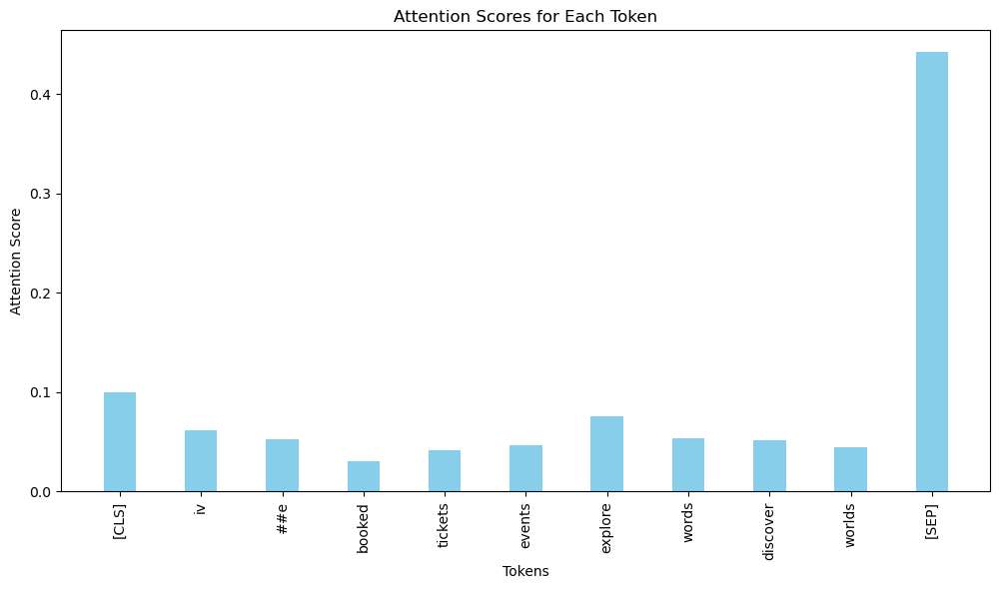

In [39]:
def visualize_attention_bar_chart(text, attention, tokenizer, layer=0, head=0, save_path=None):
    tokens = tokenizer.tokenize(text)
    tokens = ['[CLS]'] + tokens + ['[SEP]']
    
    attention = attention[layer][head].cpu().detach().numpy()
    attention = attention[0, 0, :len(tokens)]  # Take the attention scores for the first token (CLS token)
    
    fig, ax = plt.subplots(figsize=(12, 6))
    bar_width = 0.4
    x = np.arange(len(tokens))
    
    ax.bar(x, attention, width=bar_width, color='skyblue')
    ax.set_xticks(x)
    ax.set_xticklabels(tokens, rotation=90)
    ax.set_xlabel('Tokens')
    ax.set_ylabel('Attention Score')
    ax.set_title('Attention Scores for Each Token')

    if save_path:
        plt.savefig(save_path)
    else:
        plt.show()

# Select an example tweet from the training data
example_text = sentiment_df.loc[0, 'text']

# Tokenize the example tweet
encoded_dict = tokenizer.encode_plus(
    example_text,
    add_special_tokens=True,
    max_length=128,
    pad_to_max_length=True,
    return_attention_mask=True,
    return_tensors='pt'
)

input_ids = encoded_dict['input_ids'].cuda()
attention_mask = encoded_dict['attention_mask'].cuda()

# Get the model outputs and attention weights
cnn_model.eval()
with torch.no_grad():
    _, attentions = cnn_model(input_ids, attention_mask)

# Visualize and save the attention weights using a bar chart
visualize_attention_bar_chart(example_text, attentions, tokenizer, layer=0, head=0, save_path='attention_bar_chart.png')


C:\Users\ASUS\anaconda3\Lib\site-packages\transformers\tokenization_utils_base.py:2699: FutureWarning:

The `pad_to_max_length` argument is deprecated and will be removed in a future version, use `padding=True` or `padding='longest'` to pad to the longest sequence in the batch, or use `padding='max_length'` to pad to a max length. In this case, you can give a specific length with `max_length` (e.g. `max_length=45`) or leave max_length to None to pad to the maximal input size of the model (e.g. 512 for Bert).



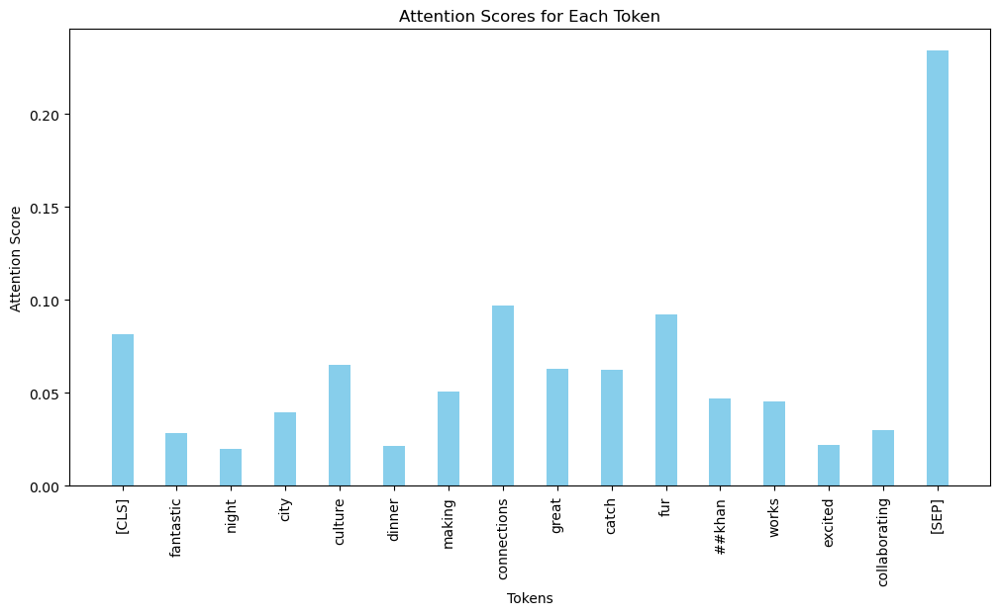

In [107]:
def visualize_attention_bar_chart(text, attention, tokenizer, layer=0, head=0, save_path=None):
    tokens = tokenizer.tokenize(text)
    tokens = ['[CLS]'] + tokens + ['[SEP]']
    
    attention = attention[layer][head].cpu().detach().numpy()
    attention = attention[0, 0, :len(tokens)]  # Take the attention scores for the first token (CLS token)
    
    fig, ax = plt.subplots(figsize=(12, 6))
    bar_width = 0.4
    x = np.arange(len(tokens))
    
    ax.bar(x, attention, width=bar_width, color='skyblue')
    ax.set_xticks(x)
    ax.set_xticklabels(tokens, rotation=90)
    ax.set_xlabel('Tokens')
    ax.set_ylabel('Attention Score')
    ax.set_title('Attention Scores for Each Token')

    if save_path:
        plt.savefig(save_path)
    else:
        plt.show()

# Select an example tweet from the training data
example_text = sentiment_df.loc[110, 'text']

# Tokenize the example tweet
encoded_dict = tokenizer.encode_plus(
    example_text,
    add_special_tokens=True,
    max_length=128,
    pad_to_max_length=True,
    return_attention_mask=True,
    return_tensors='pt'
)

input_ids = encoded_dict['input_ids'].cuda()
attention_mask = encoded_dict['attention_mask'].cuda()

# Get the model outputs and attention weights for RNN
rnn_model.eval()
with torch.no_grad():
    _, attentions = rnn_model(input_ids, attention_mask)

# Visualize and save the attention weights using a bar chart
visualize_attention_bar_chart(example_text, attentions, tokenizer, layer=0, head=0, save_path='attention_bar_chart_rnn.png')


In [57]:
# Function to get emotion predictions
def predict_emotions(model, dataloader):
    model.eval()
    predictions = []
    
    for batch in dataloader:
        input_ids, attention_masks = [t.cuda() for t in batch]
        
        with torch.no_grad():
            outputs = model(input_ids=input_ids, attention_mask=attention_masks)
            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).cpu().numpy()
        
        predictions.extend(preds)
    
    return predictions

# Get predictions
predicted_classes = predict_emotions(model, emotion_dataloader)

# Map predictions to emotion labels
emotions = ["sadness", "joy", "love", "anger", "fear", "surprise"]
predicted_emotions = [emotions[i] for i in predicted_classes]

# Add the predictions to your DataFrame
sentiment_df['predicted_emotion'] = predicted_emotions

# Display the first few rows with predictions
print(sentiment_df.head())


C:\Users\ASUS\anaconda3\Lib\site-packages\transformers\models\bert\modeling_bert.py:439: UserWarning: 1Torch was not compiled with flash attention. (Triggered internally at ..\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:455.)
  attn_output = torch.nn.functional.scaled_dot_product_attention(


                                                text  sentiment  sentiment  \
0  ive booked tickets events explore words discov...          0          0   
1  shoes news check waynes uncovered interview ar...          0          0   
2  shoes news hey american friendscheck us amazin...          1          1   
3  friday th september holding evening philippas ...          1          1   
4  creative earth eco fest produced photo hub nor...          1          1   

  predicted_emotion  
0               joy  
1               joy  
2               joy  
3               joy  
4               joy  


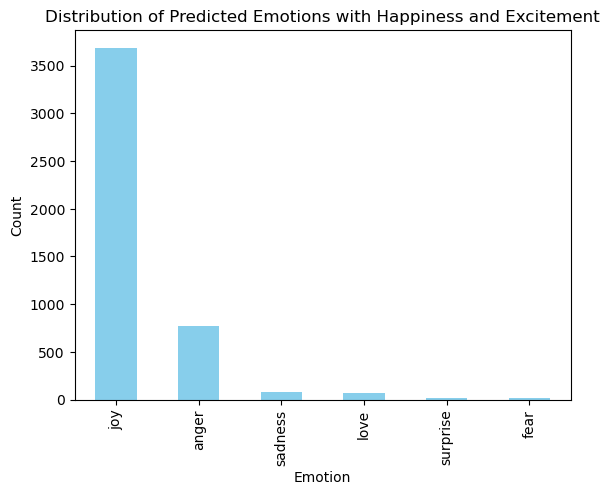

In [59]:
# Plot the distribution of the expanded predicted emotions
emotion_counts = sentiment_df['predicted_emotion'].value_counts()
emotion_counts.plot(kind='bar', color='skyblue')
plt.title('Distribution of Predicted Emotions with Happiness and Excitement')
plt.xlabel('Emotion')
plt.ylabel('Count')
plt.show()


In [273]:
pip install bertviz

Note: you may need to restart the kernel to use updated packages.


## Attention Visualization with BERTViz
BERTViz is used to visualize attention mechanisms within the BERT models. This helps in understanding which words or phrases the models focus on when making sentiment predictions, providing deeper insights into how the models interpret the data.


In [169]:
# Load pre-trained BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

def predict_proba_cnn(texts):
    cnn_model.eval()
    input_ids = [tokenizer.encode(text, add_special_tokens=True, max_length=128, truncation=True) for text in texts]
    input_ids = pad_sequences(input_ids, maxlen=128, dtype="long", truncating="post", padding="post")
    attention_masks = [[float(i > 0) for i in seq] for seq in input_ids]

    inputs = torch.tensor(input_ids).cuda()
    masks = torch.tensor(attention_masks).cuda()

    with torch.no_grad():
        outputs, attentions = cnn_model(inputs, masks)  # Include attentions for BERTViz
        probs = torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()
    
    return probs, attentions  # Return both probabilities and attentions for visualization

def preprocess_data(texts, max_length=128):
    inputs = tokenizer(texts, padding=True, truncation=True, max_length=max_length, return_tensors='pt')
    input_ids = inputs['input_ids']
    attention_masks = inputs['attention_mask']
    return input_ids, attention_masks

instance_66_text = sentiment_df.loc[66, 'text']

# Preprocess the instance
input_ids, attention_masks = preprocess_data([instance_66_text])
input_ids = input_ids.cuda()
attention_masks = attention_masks.cuda()

# Get predictions and attentions for BERT-CNN model
_, attentions_cnn = predict_proba_cnn([instance_66_text])

# Calculate the actual number of tokens in the input sequence
num_tokens = len(tokenizer.tokenize(instance_66_text)) + 2  # +2 for [CLS] and [SEP]

# Truncate attention matrices to match the actual token count
# Note: attentions_cnn is a list of tensors for each layer
# Each tensor in attentions_cnn is of shape [batch_size, num_heads, seq_length, seq_length]
# We need to truncate seq_length to num_tokens
truncated_attentions_cnn = [att[:, :, :num_tokens, :num_tokens] for att in attentions_cnn]

# Visualize using BERTViz head view
tokens = tokenizer.convert_ids_to_tokens(input_ids[0].cpu().numpy()[:num_tokens])
head_view(truncated_attentions_cnn, tokens)


<IPython.core.display.Javascript object>

In [129]:
# Load pre-trained BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Function to visualize attention using head_view
def visualize_attention_head_view(model, text):
    model.eval()

    # Tokenize input text
    inputs = tokenizer.encode_plus(
        text,
        add_special_tokens=True,
        return_tensors="pt"
    )
    
    input_ids = inputs['input_ids'].cuda()
    attention_mask = inputs['attention_mask'].cuda()

    # Get the model outputs (logits and attention weights)
    with torch.no_grad():
        outputs, attentions = model(input_ids, attention_mask)

    # Decode the tokens
    tokens = tokenizer.convert_ids_to_tokens(input_ids[0])

    # Use BERTViz's `head_view` to visualize attention across heads
    head_view(attentions, tokens)

# Example text to visualize
text = "Bradford named 4th worst place to live in the UK... I can't see my city on here. I can't relate."

# Visualize attention for BERT-CNN model
print("BERT-CNN Model Head View Attention Visualization:")
visualize_attention_head_view(cnn_model, text)

# Visualize attention for BERT-RNN model
print("BERT-RNN Model Head View Attention Visualization:")
visualize_attention_head_view(rnn_model, text)


BERT-CNN Model Head View Attention Visualization:


<IPython.core.display.Javascript object>

BERT-RNN Model Head View Attention Visualization:


<IPython.core.display.Javascript object>

In [34]:
pip install -U kaleido

Note: you may need to restart the kernel to use updated packages.


In [41]:
def evaluate_model(model, dataloader):
    model.eval()
    true_labels = []
    predictions = []
    
    for batch in dataloader:
        batch = tuple(t.cuda() for t in batch)
        inputs, masks, labels = batch
        
        with torch.no_grad():
            outputs, _ = model(inputs, masks)  # Unpack the tuple to get only the logits
            preds = torch.argmax(outputs, dim=1).flatten()
        
        predictions.extend(preds.cpu().numpy())
        true_labels.extend(labels.cpu().numpy())
    
    return np.array(true_labels), np.array(predictions)

# Evaluate on Validation Set for CNN Model
true_labels_cnn, predictions_cnn = evaluate_model(cnn_model, val_dataloader)
target_names = [str(cls) for cls in label_encoder.classes_]

report_cnn = classification_report(true_labels_cnn, predictions_cnn, target_names=target_names)
print("BERT with CNN - Classification Report:\n", report_cnn)

conf_matrix_cnn = confusion_matrix(true_labels_cnn, predictions_cnn)
print("BERT with CNN - Confusion Matrix:\n", conf_matrix_cnn)

# Evaluate on Validation Set for RNN Model
true_labels_rnn, predictions_rnn = evaluate_model(rnn_model, val_dataloader)

report_rnn = classification_report(true_labels_rnn, predictions_rnn, target_names=target_names)
print("BERT with RNN - Classification Report:\n", report_rnn)

conf_matrix_rnn = confusion_matrix(true_labels_rnn, predictions_rnn)
print("BERT with RNN - Confusion Matrix:\n", conf_matrix_rnn)


BERT with CNN - Classification Report:
               precision    recall  f1-score   support

          -1       0.61      0.33      0.42        43
           0       0.88      0.82      0.85       397
           1       0.84      0.92      0.88       488

    accuracy                           0.85       928
   macro avg       0.78      0.69      0.72       928
weighted avg       0.85      0.85      0.84       928

BERT with CNN - Confusion Matrix:
 [[ 14   9  20]
 [  4 327  66]
 [  5  35 448]]
BERT with RNN - Classification Report:
               precision    recall  f1-score   support

          -1       0.62      0.30      0.41        43
           0       0.87      0.85      0.86       397
           1       0.85      0.91      0.88       488

    accuracy                           0.86       928
   macro avg       0.78      0.69      0.72       928
weighted avg       0.85      0.86      0.85       928

BERT with RNN - Confusion Matrix:
 [[ 13  11  19]
 [  4 336  57]
 [  4  39 44

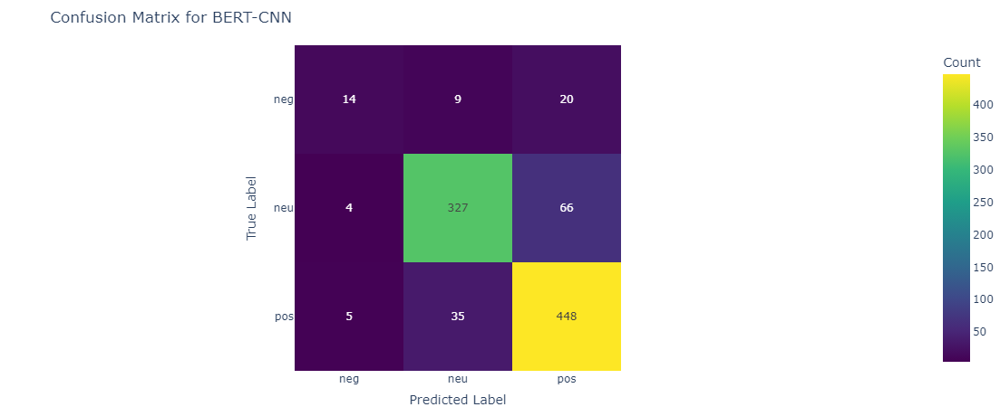

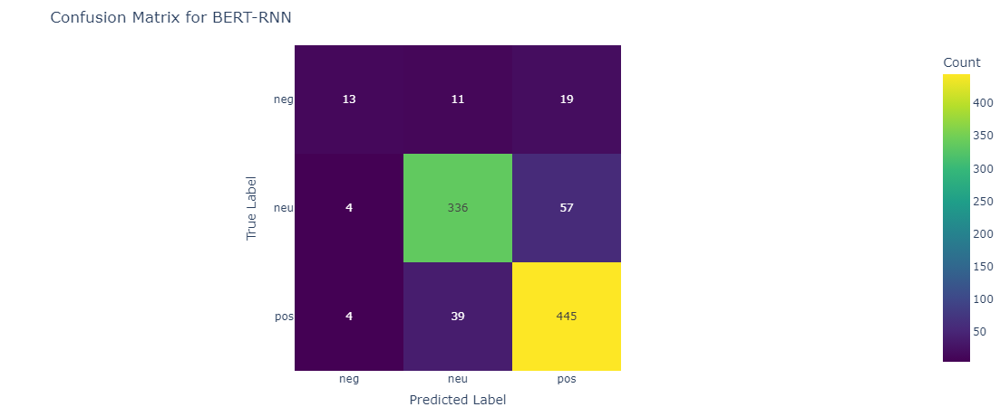

In [43]:
# Use labels corresponding to sentiment classes
target_names = ["neg", "neu", "pos"]

def plot_confusion_matrix(true_labels, predictions, model_name):
    conf_matrix = confusion_matrix(true_labels, predictions)
    
    # Create a heatmap for the confusion matrix
    fig = px.imshow(
        conf_matrix,
        labels=dict(x="Predicted Label", y="True Label", color="Count"),
        x=target_names,
        y=target_names,
        color_continuous_scale='Viridis',
        text_auto=True  # Display the numbers inside the squares
    )
    
    fig.update_layout(
        title=f'Confusion Matrix for {model_name}',
        xaxis_title='Predicted Label',
        yaxis_title='True Label',
        width=500, 
        height=450,  
        margin=dict(l=0, r=0, t=50, b=0)  
    )
    
    fig.update_xaxes(side="bottom", constrain='domain')  
    fig.update_yaxes(constrain='domain')  
    
    fig.show()

# Plot confusion matrix for BERT-CNN
plot_confusion_matrix(true_labels_cnn, predictions_cnn, "BERT-CNN")

# Plot confusion matrix for BERT-RNN
plot_confusion_matrix(true_labels_rnn, predictions_rnn, "BERT-RNN")


In [87]:
# Save the BERT-CNN model
model_save_path = "bert_cnn_model_5_epochs_1.pth"
torch.save(cnn_model.state_dict(), 'bert_cnn_model_5_epochs_2.pth')
print(f"BERT-CNN Model saved to {model_save_path}")

BERT-CNN Model saved to bert_cnn_model_5_epochs_1.pth


In [89]:
# Save the BERT-RNN model
model_save_path = "bert_rnn_model_5_epochs_1.pth"
torch.save(rnn_model.state_dict(), 'bert_rnn_model_5_epochs_2.pth')
print(f"BERT-RNN Model saved to {model_save_path}")

BERT-RNN Model saved to bert_rnn_model_5_epochs_1.pth


In [45]:
# Inspect the label encoding
print("Original labels:", list(sentiment_df['sentiment'].unique()))
print("Encoded labels:", list(label_encoder.classes_))

Original labels: [0, 1, -1]
Encoded labels: [-1, 0, 1]


In [47]:
def predict_sentiment(model, tokenizer, text):
    model.eval()
    inputs = tokenizer.encode(text, add_special_tokens=True, max_length=128, truncation=True)
    inputs = pad_sequences([inputs], maxlen=128, dtype="long", truncating="post", padding="post")
    attention_masks = [[float(i > 0) for i in seq] for seq in inputs]
    
    inputs = torch.tensor(inputs).cuda()
    masks = torch.tensor(attention_masks).cuda()
    
    with torch.no_grad():
        outputs, _ = model(inputs, masks)  # Unpack the tuple to get only the logits
        preds = torch.argmax(outputs, dim=1).flatten()
        # Map the prediction back to original sentiment labels
        predicted_label = label_encoder.inverse_transform(preds.cpu().numpy())
        return predicted_label[0]

# Load pre-trained BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Example usage with BERT-CNN model
text = "This is a fantastic event!"
predicted_sentiment_cnn = predict_sentiment(cnn_model, tokenizer, text)
print(f"BERT-CNN Predicted sentiment: {predicted_sentiment_cnn}")

# Example usage with BERT-RNN model
predicted_sentiment_rnn = predict_sentiment(rnn_model, tokenizer, text)
print(f"BERT-RNN Predicted sentiment: {predicted_sentiment_rnn}")


BERT-CNN Predicted sentiment: 1
BERT-RNN Predicted sentiment: 1


In [49]:
import torch
import numpy as np
from keras.preprocessing.sequence import pad_sequences
from transformers import BertTokenizer

def predict_sentiment(model, tokenizer, text):
    model.eval()
    inputs = tokenizer.encode(text, add_special_tokens=True, max_length=128, truncation=True)
    inputs = pad_sequences([inputs], maxlen=128, dtype="long", truncating="post", padding="post")
    attention_masks = [[float(i > 0) for i in seq] for seq in inputs]
    
    inputs = torch.tensor(inputs).cuda()
    masks = torch.tensor(attention_masks).cuda()
    
    with torch.no_grad():
        outputs, _ = model(inputs, masks)  # Unpack the tuple to get only the logits
        preds = torch.argmax(outputs, dim=1).flatten()
        # Map the prediction back to original sentiment labels
        predicted_label = label_encoder.inverse_transform(preds.cpu().numpy())
        return predicted_label[0]

# Load pre-trained BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Example usage with BERT-CNN model
text = "ZAYN FOR BRADFORD 2025!"
predicted_sentiment_cnn = predict_sentiment(cnn_model, tokenizer, text)
print(f"BERT-CNN Predicted sentiment: {predicted_sentiment_cnn}")

# Example usage with BERT-RNN model
text = "bad place to live in"
predicted_sentiment_rnn = predict_sentiment(rnn_model, tokenizer, text)
print(f"BERT-RNN Predicted sentiment: {predicted_sentiment_rnn}")


BERT-CNN Predicted sentiment: 1
BERT-RNN Predicted sentiment: -1


In [51]:
# Load pre-trained BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

def preprocess_data(texts, max_length=128):
    inputs = tokenizer(texts, padding=True, truncation=True, max_length=max_length, return_tensors='pt')
    input_ids = inputs['input_ids']
    attention_masks = inputs['attention_mask']
    return input_ids, attention_masks


In [65]:
original_labels = [0, 1, -1]
label_encoder = LabelEncoder()
label_encoder.fit(original_labels)

# Function to preprocess data
def preprocess_data(texts, max_length=128):
    inputs = tokenizer(texts, padding=True, truncation=True, max_length=max_length, return_tensors='pt')
    input_ids = inputs['input_ids']
    attention_masks = inputs['attention_mask']
    return input_ids, attention_masks

# Function to predict and map back to original labels
def predict_and_map_with_label_encoder(model, input_ids, attention_masks, label_encoder):
    model.eval()
    with torch.no_grad():
        outputs, _ = model(input_ids, attention_masks)  # Unpack the tuple to get only the logits
        preds = torch.argmax(outputs, dim=1).flatten()
        
        # Map the prediction back to original sentiment labels
        predicted_label = label_encoder.inverse_transform(preds.cpu().numpy())
        return predicted_label

# Load pre-trained BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Example usage with new data
new_texts = [
    "Bradford named 4th worst place to live in the UK... I can't see my city on here. I can't relate."
]

# Preprocess new data
input_ids, attention_masks = preprocess_data(new_texts)
input_ids = input_ids.cuda()
attention_masks = attention_masks.cuda()

# Predict with BERT-CNN model
cnn_predictions = predict_and_map_with_label_encoder(cnn_model, input_ids, attention_masks, label_encoder)
print("BERT-CNN Predicted sentiment:", cnn_predictions[0])

# Predict with BERT-RNN model
rnn_predictions = predict_and_map_with_label_encoder(rnn_model, input_ids, attention_masks, label_encoder)
print("BERT-RNN Predicted sentiment:", rnn_predictions[0])


BERT-CNN Predicted sentiment: -1
BERT-RNN Predicted sentiment: -1


In [67]:
# Load pre-trained BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

class_names = label_encoder.classes_

In [69]:
def predict_proba_cnn(texts):
    cnn_model.eval()
    input_ids = [tokenizer.encode(text, add_special_tokens=True, max_length=128, truncation=True) for text in texts]
    input_ids = pad_sequences(input_ids, maxlen=128, dtype="long", truncating="post", padding="post")
    attention_masks = [[float(i > 0) for i in seq] for seq in input_ids]

    inputs = torch.tensor(input_ids).cuda()
    masks = torch.tensor(attention_masks).cuda()

    with torch.no_grad():
        outputs, _ = cnn_model(inputs, masks)  # Unpack the tuple to get only the logits
        probs = torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()
    
    return probs

def predict_proba_rnn(texts):
    rnn_model.eval()
    input_ids = [tokenizer.encode(text, add_special_tokens=True, max_length=128, truncation=True) for text in texts]
    input_ids = pad_sequences(input_ids, maxlen=128, dtype="long", truncating="post", padding="post")
    attention_masks = [[float(i > 0) for i in seq] for seq in input_ids]

    inputs = torch.tensor(input_ids).cuda()
    masks = torch.tensor(attention_masks).cuda()

    with torch.no_grad():
        outputs, _ = rnn_model(inputs, masks)  # Unpack the tuple to get only the logits
        probs = torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()
    
    return probs


In [71]:
def predict_labels_cnn(texts):
    probs = predict_proba_cnn(texts)
    preds = np.argmax(probs, axis=1)
    predicted_labels = label_encoder.inverse_transform(preds)
    return predicted_labels

def predict_labels_rnn(texts):
    probs = predict_proba_rnn(texts)
    preds = np.argmax(probs, axis=1)
    predicted_labels = label_encoder.inverse_transform(preds)
    return predicted_labels


In [73]:
# Initialize LIME explainer
explainer = LimeTextExplainer(class_names=class_names)


In [141]:
# Define the text to explain from instance 15
instance_15_text = sentiment_df.loc[66, 'text']


LIME Explanation for BERT-CNN:


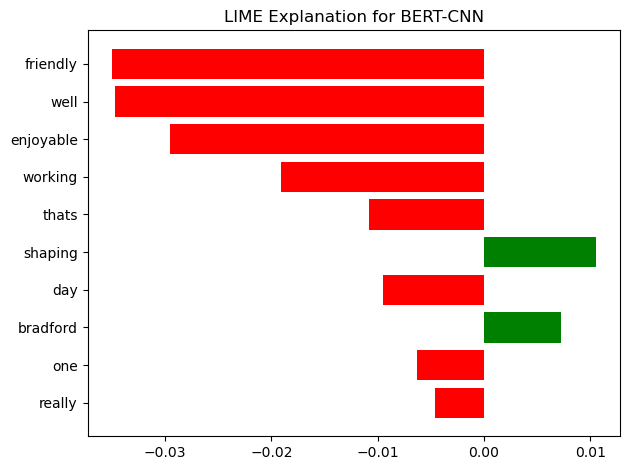

In [143]:
# Explain the prediction for BERT-CNN
exp_cnn = explainer.explain_instance(instance_15_text, predict_proba_cnn, num_features=10, num_samples=500)

# Display the explanation
print("LIME Explanation for BERT-CNN:")
exp_cnn.show_in_notebook()

# Plotting the explanation
fig = exp_cnn.as_pyplot_figure(label=exp_cnn.available_labels()[0])
plt.title('LIME Explanation for BERT-CNN')
plt.tight_layout()
plt.show()


LIME Explanation for BERT-RNN:


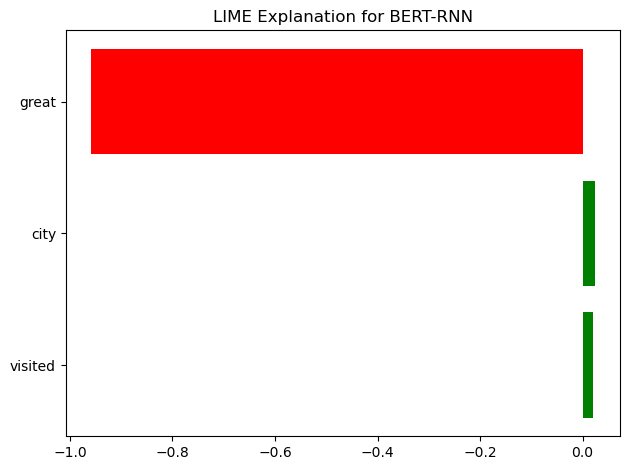

In [78]:
# Load pre-trained BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')
def predict_proba_rnn(texts):
    rnn_model.eval()
    input_ids = [tokenizer.encode(text, add_special_tokens=True, max_length=128, truncation=True) for text in texts]
    input_ids = pad_sequences(input_ids, maxlen=128, dtype="long", truncating="post", padding="post")
    attention_masks = [[float(i > 0) for i in seq] for seq in input_ids]

    inputs = torch.tensor(input_ids).cuda()
    masks = torch.tensor(attention_masks).cuda()

    with torch.no_grad():
        outputs, _ = rnn_model(inputs, masks)  # Unpack the tuple to get only the logits
        probs = torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()
    
    return probs
def predict_labels_rnn(texts):
    probs = predict_proba_rnn(texts)
    preds = np.argmax(probs, axis=1)
    predicted_labels = label_encoder.inverse_transform(preds)
    return predicted_labels
# Initialize LIME explainer
explainer = LimeTextExplainer(class_names=class_names)

# Define the text to explain from instance 15
instance_15_text = sentiment_df.loc[199, 'text']

# Explain the prediction for BERT-RNN
exp_rnn = explainer.explain_instance(instance_15_text, predict_proba_rnn, num_features=10, num_samples=500)

# Display the explanation
print("LIME Explanation for BERT-RNN:")
exp_rnn.show_in_notebook()

# Plotting the explanation
fig = exp_rnn.as_pyplot_figure(label=exp_rnn.available_labels()[0])
plt.title('LIME Explanation for BERT-RNN')
plt.tight_layout()
plt.show()


In [79]:
# Load pre-trained BERT model and tokenizer
bert_model = BertModel.from_pretrained('bert-base-uncased')
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

In [80]:
import torch.nn as nn

class BERT_BiLSTM(nn.Module):
    def __init__(self, bert, hidden_size=768, num_classes=3, lstm_units=256):
        super(BERT_BiLSTM, self).__init__()
        self.bert = bert
        self.lstm = nn.LSTM(input_size=hidden_size, hidden_size=lstm_units, num_layers=2, bidirectional=True, batch_first=True)
        self.dropout = nn.Dropout(0.5)
        self.fc = nn.Linear(lstm_units * 2, num_classes)
    
    def forward(self, input_ids, attention_mask):
        outputs = self.bert(input_ids, attention_mask=attention_mask)
        sequence_output = outputs[0]
        
        x, _ = self.lstm(sequence_output)
        x = self.dropout(x[:, -1, :])
        
        x = self.fc(x)
        return x

# Create BERT with BiLSTM model
num_classes = 3  # Update based on your number of classes
bilstm_model = BERT_BiLSTM(bert_model, num_classes=num_classes)
bilstm_model.cuda()


BERT_BiLSTM(
  (bert): BertModel(
    (embeddings): BertEmbeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (token_type_embeddings): Embedding(2, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): BertEncoder(
      (layer): ModuleList(
        (0-11): 12 x BertLayer(
          (attention): BertAttention(
            (self): BertSdpaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): BertSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_a

In [81]:
# Load pre-trained BERT tokenizer
tokenizer = BertTokenizer.from_pretrained('bert-base-uncased')

# Function to preprocess text data
def preprocess_data(texts, max_length=128):
    inputs = tokenizer(texts.tolist(), padding=True, truncation=True, max_length=max_length, return_tensors='pt')
    input_ids = inputs['input_ids']
    attention_masks = inputs['attention_mask']
    return input_ids, attention_masks

texts = sentiment_df['text'].values
labels = sentiment_df['sentiment'].values

# Encode labels using LabelEncoder
label_encoder = LabelEncoder()
encoded_labels = label_encoder.fit_transform(labels)

# Preprocess text data
input_ids, attention_masks = preprocess_data(texts)

# Convert labels to tensors
encoded_labels = torch.tensor(encoded_labels)

# Create train and validation sets
train_inputs, val_inputs, train_labels, val_labels = train_test_split(input_ids, encoded_labels, test_size=0.2)
train_masks, val_masks, _, _ = train_test_split(attention_masks, attention_masks, test_size=0.2)

# Create DataLoader
batch_size = 16

train_data = TensorDataset(train_inputs, train_masks, train_labels)
train_sampler = RandomSampler(train_data)
train_dataloader = DataLoader(train_data, sampler=train_sampler, batch_size=batch_size)

val_data = TensorDataset(val_inputs, val_masks, val_labels)
val_sampler = SequentialSampler(val_data)
val_dataloader = DataLoader(val_data, sampler=val_sampler, batch_size=batch_size)

# Define BERT with BiLSTM model
class BERT_BiLSTM(nn.Module):
    def __init__(self, bert, hidden_size=768, num_classes=3, lstm_units=256):
        super(BERT_BiLSTM, self).__init__()
        self.bert = bert
        self.lstm = nn.LSTM(input_size=hidden_size, hidden_size=lstm_units, num_layers=2, bidirectional=True, batch_first=True)
        self.dropout = nn.Dropout(0.5)
        self.fc = nn.Linear(lstm_units * 2, num_classes)
    
    def forward(self, input_ids, attention_mask):
        outputs = self.bert(input_ids, attention_mask=attention_mask)
        sequence_output = outputs[0]
        
        x, _ = self.lstm(sequence_output)
        x = self.dropout(x[:, -1, :])
        
        x = self.fc(x)
        return x

# Load pre-trained BERT
bert_model = BertModel.from_pretrained('bert-base-uncased')

# Create BERT with BiLSTM model
num_classes = len(label_encoder.classes_)  # Number of classes
bilstm_model = BERT_BiLSTM(bert_model, num_classes=num_classes)
bilstm_model.cuda()

def train_model(model, train_dataloader, val_dataloader, epochs=5):
    optimizer = optim.AdamW(model.parameters(), lr=2e-5, weight_decay=0.01)
    loss_fn = nn.CrossEntropyLoss()

    for epoch in range(epochs):
        model.train()
        total_loss = 0
        for step, batch in enumerate(train_dataloader):
            batch = tuple(t.cuda() for t in batch)
            inputs, masks, labels = batch
            model.zero_grad()
            outputs = model(inputs, masks)
            loss = loss_fn(outputs, labels)
            total_loss += loss.item()
            loss.backward()
            optimizer.step()
        
        avg_train_loss = total_loss / len(train_dataloader)
        print(f"Epoch {epoch + 1}, Training loss: {avg_train_loss}")
        
        model.eval()
        eval_loss, eval_accuracy = 0, 0
        for batch in val_dataloader:
            batch = tuple(t.cuda() for t in batch)
            inputs, masks, labels = batch
            with torch.no_grad():
                outputs = model(inputs, masks)
                loss = loss_fn(outputs, labels)
                eval_loss += loss.item()
                preds = torch.argmax(outputs, dim=1).flatten()
                eval_accuracy += (preds == labels).cpu().numpy().mean()
        
        avg_val_loss = eval_loss / len(val_dataloader)
        avg_val_accuracy = eval_accuracy / len(val_dataloader)
        print(f"Epoch {epoch + 1}, Validation loss: {avg_val_loss}, Validation accuracy: {avg_val_accuracy}")

# Train the model
train_model(bilstm_model, train_dataloader, val_dataloader, epochs=5)

# Prediction function
def predict_with_bilstm(model, text):
    model.eval()
    
    # Ensure the text input is correctly formatted as a list of strings
    if isinstance(text, str):
        inputs = tokenizer([text], padding=True, truncation=True, max_length=128, return_tensors='pt')
    else:
        raise ValueError("Input text must be a string")
    
    inputs = inputs['input_ids'].cuda()
    masks = inputs.ne(0).cuda()  # Create attention mask

    with torch.no_grad():
        outputs = model(inputs, masks)
        preds = torch.argmax(outputs, dim=1).flatten()
        # Map the prediction back to original sentiment labels
        predicted_label = label_encoder.inverse_transform(preds.cpu().numpy())
        return predicted_label[0]

# Example usage
example_text = "This is an amazing event with lots of excitement!"
predicted_sentiment = predict_with_bilstm(bilstm_model, example_text)
print(f"Predicted sentiment: {predicted_sentiment}")


C:\Users\ASUS\anaconda3\Lib\site-packages\transformers\models\bert\modeling_bert.py:435: UserWarning:

1Torch was not compiled with flash attention. (Triggered internally at ..\aten\src\ATen\native\transformers\cuda\sdp_utils.cpp:455.)



Epoch 1, Training loss: 0.6568017492135023
Epoch 1, Validation loss: 0.44649259001016617, Validation accuracy: 0.822198275862069
Epoch 2, Training loss: 0.3896771846981398
Epoch 2, Validation loss: 0.37835281522109593, Validation accuracy: 0.8491379310344828
Epoch 3, Training loss: 0.27260861594775887
Epoch 3, Validation loss: 0.40791316629098406, Validation accuracy: 0.8491379310344828
Epoch 4, Training loss: 0.18558106392798623
Epoch 4, Validation loss: 0.38303334288427543, Validation accuracy: 0.8717672413793104
Epoch 5, Training loss: 0.14878643085329055
Epoch 5, Validation loss: 0.37442650999231586, Validation accuracy: 0.875
Predicted sentiment: 1


In [82]:
# Example usage
example_text = "Bradford City are a shambles, Bradford Bulls are pretty much amateur and Bradford Council is bankrupt. The place is a dump, sketchy at night and you can’t drive anywhere because most of it is dug up. Is there a more depressing place in the UK?"
predicted_sentiment = predict_with_bilstm(bilstm_model, example_text)
print(f"Predicted sentiment: {predicted_sentiment}")

Predicted sentiment: 1


Classification Report: BiLSTM
               precision    recall  f1-score   support

         neg       0.69      0.41      0.51        27
         neu       0.93      0.80      0.86       396
         pos       0.85      0.96      0.90       505

    accuracy                           0.88       928
   macro avg       0.82      0.72      0.76       928
weighted avg       0.88      0.88      0.87       928



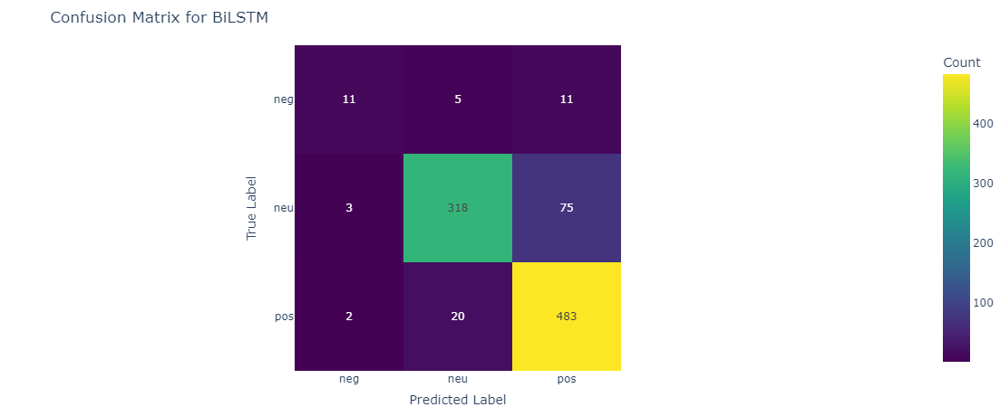

In [83]:
# Function to get predictions on validation set
def get_predictions(model, dataloader):
    model.eval()
    predictions = []
    true_labels = []
    
    for batch in dataloader:
        batch = tuple(t.cuda() for t in batch)
        inputs, masks, labels = batch
        
        with torch.no_grad():
            outputs = model(inputs, masks)
            preds = torch.argmax(outputs, dim=1).flatten()
        
        predictions.extend(preds.cpu().numpy())
        true_labels.extend(labels.cpu().numpy())
    
    return true_labels, predictions

# Get predictions and true labels for BiLSTM model
true_labels, predictions = get_predictions(bilstm_model, val_dataloader)

# Convert encoded class labels to strings for classification report
target_names = ["neg", "neu", "pos"]

# Generate the classification report
report = classification_report(true_labels, predictions, target_names=target_names)
print("Classification Report: BiLSTM\n", report)

# Generate the confusion matrix
conf_matrix = confusion_matrix(true_labels, predictions)

# Create a heatmap for the confusion matrix
fig = px.imshow(
    conf_matrix,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=target_names,
    y=target_names,
    color_continuous_scale='Viridis',
    text_auto=True  
)

fig.update_layout(
    title='Confusion Matrix for BiLSTM',
    xaxis_title='Predicted Label',
    yaxis_title='True Label',
    width=500,  
    height=450,  
    margin=dict(l=0, r=0, t=50, b=0)  
)

fig.update_xaxes(side="bottom", constrain='domain')  
fig.update_yaxes(constrain='domain')  

fig.show()


LIME Explanation for BERT-BiLSTM:


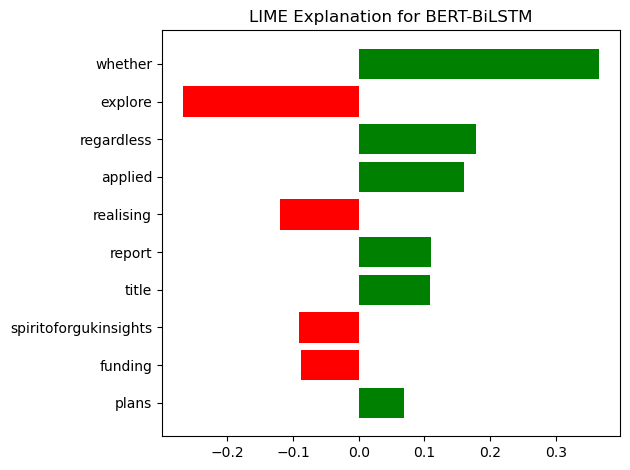

In [95]:
# Initialize LIME explainer
explainer = LimeTextExplainer(class_names=class_names)

def predict_proba_bilstm(texts):
    bilstm_model.eval()
    input_ids = [tokenizer.encode(text, add_special_tokens=True, max_length=128, truncation=True) for text in texts]
    input_ids = pad_sequences(input_ids, maxlen=128, dtype="long", truncating="post", padding="post")
    attention_masks = [[float(i > 0) for i in seq] for seq in input_ids]

    inputs = torch.tensor(input_ids).cuda()
    masks = torch.tensor(attention_masks).cuda()

    with torch.no_grad():
        outputs = bilstm_model(inputs, masks)
        probs = torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()
    
    return probs

# Define the text to explain from instance 15
instance_15_text = sentiment_df.loc[15, 'text']

# Explain the prediction for BERT-BiLSTM
exp_bilstm = explainer.explain_instance(instance_15_text, predict_proba_bilstm, num_features=10, num_samples=500)

# Display the explanation
print("LIME Explanation for BERT-BiLSTM:")
exp_bilstm.show_in_notebook()

# Plotting the explanation
fig = exp_bilstm.as_pyplot_figure(label=exp_bilstm.available_labels()[0])
plt.title('LIME Explanation for BERT-BiLSTM')
plt.tight_layout()
plt.show()


In [97]:
# Load pre-trained RoBERTa model and tokenizer
roberta_tokenizer = RobertaTokenizer.from_pretrained('roberta-base')
roberta_model = RobertaForSequenceClassification.from_pretrained('roberta-base', num_labels=3)
roberta_model.cuda()

# Load pre-trained DistilBERT model and tokenizer
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
distilbert_model = DistilBertForSequenceClassification.from_pretrained('distilbert-base-uncased', num_labels=3)
distilbert_model.cuda()

# Function to preprocess text data
def preprocess_data_roberta(texts, max_length=128):
    inputs = roberta_tokenizer(texts.tolist(), padding=True, truncation=True, max_length=max_length, return_tensors='pt')
    input_ids = inputs['input_ids']
    attention_masks = inputs['attention_mask']
    return input_ids, attention_masks

def preprocess_data_distilbert(texts, max_length=128):
    inputs = distilbert_tokenizer(texts.tolist(), padding=True, truncation=True, max_length=max_length, return_tensors='pt')
    input_ids = inputs['input_ids']
    attention_masks = inputs['attention_mask']
    return input_ids, attention_masks

texts = sentiment_df['text'].values
labels = sentiment_df['sentiment'].values

# Encode labels using LabelEncoder
label_encoder = LabelEncoder()
encoded_labels = label_encoder.fit_transform(labels)

# Preprocess text data for RoBERTa
input_ids_roberta, attention_masks_roberta = preprocess_data_roberta(texts)

# Preprocess text data for DistilBERT
input_ids_distilbert, attention_masks_distilbert = preprocess_data_distilbert(texts)

# Convert labels to tensors
encoded_labels = torch.tensor(encoded_labels)

# Create train and validation sets for RoBERTa
train_inputs_roberta, val_inputs_roberta, train_labels_roberta, val_labels_roberta = train_test_split(input_ids_roberta, encoded_labels, test_size=0.2)
train_masks_roberta, val_masks_roberta, _, _ = train_test_split(attention_masks_roberta, attention_masks_roberta, test_size=0.2)

# Create train and validation sets for DistilBERT
train_inputs_distilbert, val_inputs_distilbert, train_labels_distilbert, val_labels_distilbert = train_test_split(input_ids_distilbert, encoded_labels, test_size=0.2)
train_masks_distilbert, val_masks_distilbert, _, _ = train_test_split(attention_masks_distilbert, attention_masks_distilbert, test_size=0.2)

# Create DataLoader for RoBERTa
batch_size = 16

train_data_roberta = TensorDataset(train_inputs_roberta, train_masks_roberta, train_labels_roberta)
train_sampler_roberta = RandomSampler(train_data_roberta)
train_dataloader_roberta = DataLoader(train_data_roberta, sampler=train_sampler_roberta, batch_size=batch_size)

val_data_roberta = TensorDataset(val_inputs_roberta, val_masks_roberta, val_labels_roberta)
val_sampler_roberta = SequentialSampler(val_data_roberta)
val_dataloader_roberta = DataLoader(val_data_roberta, sampler=val_sampler_roberta, batch_size=batch_size)

# Create DataLoader for DistilBERT
train_data_distilbert = TensorDataset(train_inputs_distilbert, train_masks_distilbert, train_labels_distilbert)
train_sampler_distilbert = RandomSampler(train_data_distilbert)
train_dataloader_distilbert = DataLoader(train_data_distilbert, sampler=train_sampler_distilbert, batch_size=batch_size)

val_data_distilbert = TensorDataset(val_inputs_distilbert, val_masks_distilbert, val_labels_distilbert)
val_sampler_distilbert = SequentialSampler(val_data_distilbert)
val_dataloader_distilbert = DataLoader(val_data_distilbert, sampler=val_sampler_distilbert, batch_size=batch_size)

# Define training function
def train_model(model, train_dataloader, val_dataloader, epochs=5):
    optimizer = optim.AdamW(model.parameters(), lr=2e-5, weight_decay=0.01)
    loss_fn = nn.CrossEntropyLoss()

    for epoch in range(epochs):
        model.train()
        total_loss = 0
        for step, batch in enumerate(train_dataloader):
            inputs, masks, labels = [t.cuda() for t in batch]
            model.zero_grad()
            outputs = model(input_ids=inputs, attention_mask=masks, labels=labels)
            loss = outputs.loss
            total_loss += loss.item()
            loss.backward()
            optimizer.step()
        
        avg_train_loss = total_loss / len(train_dataloader)
        print(f"Epoch {epoch + 1}, Training loss: {avg_train_loss}")
        
        model.eval()
        eval_loss, eval_accuracy = 0, 0
        for batch in val_dataloader:
            inputs, masks, labels = [t.cuda() for t in batch]
            with torch.no_grad():
                outputs = model(input_ids=inputs, attention_mask=masks, labels=labels)
                loss = outputs.loss
                logits = outputs.logits
                eval_loss += loss.item()
                preds = torch.argmax(logits, dim=1).flatten()
                eval_accuracy += (preds == labels).cpu().numpy().mean()
        
        avg_val_loss = eval_loss / len(val_dataloader)
        avg_val_accuracy = eval_accuracy / len(val_dataloader)
        print(f"Epoch {epoch + 1}, Validation loss: {avg_val_loss}, Validation accuracy: {avg_val_accuracy}")

# Train the RoBERTa model
train_model(roberta_model, train_dataloader_roberta, val_dataloader_roberta, epochs=5)

# Train the DistilBERT model
train_model(distilbert_model, train_dataloader_distilbert, val_dataloader_distilbert, epochs=5)

# Define evaluation function
def get_predictions(model, dataloader):
    model.eval()
    predictions = []
    true_labels = []
    
    for batch in dataloader:
        inputs, masks, labels = [t.cuda() for t in batch]
        with torch.no_grad():
            outputs = model(input_ids=inputs, attention_mask=masks)
            logits = outputs.logits
            preds = torch.argmax(logits, dim=1).flatten()
        
        predictions.extend(preds.cpu().numpy())
        true_labels.extend(labels.cpu().numpy())
    
    return true_labels, predictions

# Get predictions and true labels for RoBERTa model
true_labels_roberta, predictions_roberta = get_predictions(roberta_model, val_dataloader_roberta)

# Get predictions and true labels for DistilBERT model
true_labels_distilbert, predictions_distilbert = get_predictions(distilbert_model, val_dataloader_distilbert)

# Convert encoded class labels to strings for classification report
target_names = list(map(str, label_encoder.classes_))

# Generate the classification report for RoBERTa
report_roberta = classification_report(true_labels_roberta, predictions_roberta, target_names=target_names)
print("RoBERTa Classification Report:\n", report_roberta)

# Generate the classification report for DistilBERT
report_distilbert = classification_report(true_labels_distilbert, predictions_distilbert, target_names=target_names)
print("DistilBERT Classification Report:\n", report_distilbert)


Some weights of RobertaForSequenceClassification were not initialized from the model checkpoint at roberta-base and are newly initialized: ['classifier.dense.bias', 'classifier.dense.weight', 'classifier.out_proj.bias', 'classifier.out_proj.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Some weights of DistilBertForSequenceClassification were not initialized from the model checkpoint at distilbert-base-uncased and are newly initialized: ['classifier.bias', 'classifier.weight', 'pre_classifier.bias', 'pre_classifier.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Epoch 1, Training loss: 0.5977398634342284
Epoch 1, Validation loss: 0.40363382368252193, Validation accuracy: 0.8318965517241379
Epoch 2, Training loss: 0.3607391866710808
Epoch 2, Validation loss: 0.36368915249176065, Validation accuracy: 0.8545258620689655
Epoch 3, Training loss: 0.27078035065165623
Epoch 3, Validation loss: 0.36027788158891527, Validation accuracy: 0.853448275862069
Epoch 4, Training loss: 0.19529333095274995
Epoch 4, Validation loss: 0.4187236456682199, Validation accuracy: 0.8717672413793104
Epoch 5, Training loss: 0.17396260406179676
Epoch 5, Validation loss: 0.4656569243826229, Validation accuracy: 0.853448275862069
Epoch 1, Training loss: 0.6057312245127456
Epoch 1, Validation loss: 0.4690911782712772, Validation accuracy: 0.8135775862068966
Epoch 2, Training loss: 0.32198349357550515
Epoch 2, Validation loss: 0.43138954788446426, Validation accuracy: 0.8394396551724138
Epoch 3, Training loss: 0.17118886402599384
Epoch 3, Validation loss: 0.40094664429539234, 

In [98]:
print(f"Length of true labels: {len(true_labels_roberta)}")
print(f"Length of predictions: {len(predictions_roberta)}")


Length of true labels: 928
Length of predictions: 928


In [99]:
# Load pre-trained RoBERTa model and tokenizer
roberta_tokenizer = RobertaTokenizer.from_pretrained('roberta-base')
roberta_model = RobertaModel.from_pretrained('roberta-base')


Some weights of RobertaModel were not initialized from the model checkpoint at roberta-base and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [100]:
class RoBERTa_CNN(nn.Module):
    def __init__(self, roberta, hidden_size=768, num_classes=3, cnn_filters=256):
        super(RoBERTa_CNN, self).__init__()
        self.roberta = roberta
        self.conv1 = nn.Conv1d(in_channels=hidden_size, out_channels=cnn_filters, kernel_size=3, padding=1)
        self.dropout = nn.Dropout(0.5)
        self.fc = nn.Linear(cnn_filters, num_classes)
    
    def forward(self, input_ids, attention_mask):
        outputs = self.roberta(input_ids, attention_mask=attention_mask)
        sequence_output = outputs[0]
        
        x = sequence_output.permute(0, 2, 1)
        x = self.conv1(x)
        x = nn.ReLU()(x)
        x = torch.max(x, dim=2)[0]
        
        x = self.dropout(x)
        x = self.fc(x)
        return x

# Create RoBERTa with CNN model
num_classes = len(label_encoder.classes_)
roberta_cnn_model = RoBERTa_CNN(roberta_model, num_classes=num_classes)
roberta_cnn_model.cuda()


RoBERTa_CNN(
  (roberta): RobertaModel(
    (embeddings): RobertaEmbeddings(
      (word_embeddings): Embedding(50265, 768, padding_idx=1)
      (position_embeddings): Embedding(514, 768, padding_idx=1)
      (token_type_embeddings): Embedding(1, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-05, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (encoder): RobertaEncoder(
      (layer): ModuleList(
        (0-11): 12 x RobertaLayer(
          (attention): RobertaAttention(
            (self): RobertaSelfAttention(
              (query): Linear(in_features=768, out_features=768, bias=True)
              (key): Linear(in_features=768, out_features=768, bias=True)
              (value): Linear(in_features=768, out_features=768, bias=True)
              (dropout): Dropout(p=0.1, inplace=False)
            )
            (output): RobertaSelfOutput(
              (dense): Linear(in_features=768, out_features=768, bias=True)
              (LayerNorm): LayerNo

In [101]:
# Load pre-trained DistilBERT model and tokenizer
distilbert_tokenizer = DistilBertTokenizer.from_pretrained('distilbert-base-uncased')
distilbert_model = DistilBertModel.from_pretrained('distilbert-base-uncased')


In [102]:
class DistilBERT_CNN(nn.Module):
    def __init__(self, distilbert, hidden_size=768, num_classes=3, cnn_filters=256):
        super(DistilBERT_CNN, self).__init__()
        self.distilbert = distilbert
        self.conv1 = nn.Conv1d(in_channels=hidden_size, out_channels=cnn_filters, kernel_size=3, padding=1)
        self.dropout = nn.Dropout(0.5)
        self.fc = nn.Linear(cnn_filters, num_classes)
    
    def forward(self, input_ids, attention_mask):
        outputs = self.distilbert(input_ids, attention_mask=attention_mask)
        sequence_output = outputs[0]
        
        x = sequence_output.permute(0, 2, 1)
        x = self.conv1(x)
        x = nn.ReLU()(x)
        x = torch.max(x, dim=2)[0]
        
        x = self.dropout(x)
        x = self.fc(x)
        return x

# Create DistilBERT with CNN model
distilbert_cnn_model = DistilBERT_CNN(distilbert_model, num_classes=num_classes)
distilbert_cnn_model.cuda()


DistilBERT_CNN(
  (distilbert): DistilBertModel(
    (embeddings): Embeddings(
      (word_embeddings): Embedding(30522, 768, padding_idx=0)
      (position_embeddings): Embedding(512, 768)
      (LayerNorm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
      (dropout): Dropout(p=0.1, inplace=False)
    )
    (transformer): Transformer(
      (layer): ModuleList(
        (0-5): 6 x TransformerBlock(
          (attention): MultiHeadSelfAttention(
            (dropout): Dropout(p=0.1, inplace=False)
            (q_lin): Linear(in_features=768, out_features=768, bias=True)
            (k_lin): Linear(in_features=768, out_features=768, bias=True)
            (v_lin): Linear(in_features=768, out_features=768, bias=True)
            (out_lin): Linear(in_features=768, out_features=768, bias=True)
          )
          (sa_layer_norm): LayerNorm((768,), eps=1e-12, elementwise_affine=True)
          (ffn): FFN(
            (dropout): Dropout(p=0.1, inplace=False)
            (lin1): Li

In [103]:
def preprocess_data_roberta(texts, max_length=128):
    inputs = roberta_tokenizer(texts.tolist(), padding=True, truncation=True, max_length=max_length, return_tensors='pt')
    input_ids = inputs['input_ids']
    attention_masks = inputs['attention_mask']
    return input_ids, attention_masks

def preprocess_data_distilbert(texts, max_length=128):
    inputs = distilbert_tokenizer(texts.tolist(), padding=True, truncation=True, max_length=max_length, return_tensors='pt')
    input_ids = inputs['input_ids']
    attention_masks = inputs['attention_mask']
    return input_ids, attention_masks

# Preprocess text data for RoBERTa
input_ids_roberta, attention_masks_roberta = preprocess_data_roberta(texts)

# Preprocess text data for DistilBERT
input_ids_distilbert, attention_masks_distilbert = preprocess_data_distilbert(texts)

# Convert labels to tensors
encoded_labels = torch.tensor(encoded_labels)

# Create train and validation sets for RoBERTa
train_inputs_roberta, val_inputs_roberta, train_labels_roberta, val_labels_roberta = train_test_split(input_ids_roberta, encoded_labels, test_size=0.2)
train_masks_roberta, val_masks_roberta, _, _ = train_test_split(attention_masks_roberta, attention_masks_roberta, test_size=0.2)

# Create train and validation sets for DistilBERT
train_inputs_distilbert, val_inputs_distilbert, train_labels_distilbert, val_labels_distilbert = train_test_split(input_ids_distilbert, encoded_labels, test_size=0.2)
train_masks_distilbert, val_masks_distilbert, _, _ = train_test_split(attention_masks_distilbert, attention_masks_distilbert, test_size=0.2)

# Create DataLoader for RoBERTa
batch_size = 16

train_data_roberta = TensorDataset(train_inputs_roberta, train_masks_roberta, train_labels_roberta)
train_sampler_roberta = RandomSampler(train_data_roberta)
train_dataloader_roberta = DataLoader(train_data_roberta, sampler=train_sampler_roberta, batch_size=batch_size)

val_data_roberta = TensorDataset(val_inputs_roberta, val_masks_roberta, val_labels_roberta)
val_sampler_roberta = SequentialSampler(val_data_roberta)
val_dataloader_roberta = DataLoader(val_data_roberta, sampler=val_sampler_roberta, batch_size=batch_size)

# Create DataLoader for DistilBERT
train_data_distilbert = TensorDataset(train_inputs_distilbert, train_masks_distilbert, train_labels_distilbert)
train_sampler_distilbert = RandomSampler(train_data_distilbert)
train_dataloader_distilbert = DataLoader(train_data_distilbert, sampler=train_sampler_distilbert, batch_size=batch_size)

val_data_distilbert = TensorDataset(val_inputs_distilbert, val_masks_distilbert, val_labels_distilbert)
val_sampler_distilbert = SequentialSampler(val_data_distilbert)
val_dataloader_distilbert = DataLoader(val_data_distilbert, sampler=val_sampler_distilbert, batch_size=batch_size)


C:\Users\ASUS\AppData\Local\Temp\ipykernel_8564\3079692965.py:20: UserWarning:

To copy construct from a tensor, it is recommended to use sourceTensor.clone().detach() or sourceTensor.clone().detach().requires_grad_(True), rather than torch.tensor(sourceTensor).



In [104]:
def train_model(model, train_dataloader, val_dataloader, epochs=5):
    optimizer = optim.AdamW(model.parameters(), lr=2e-5, weight_decay=0.01)
    loss_fn = nn.CrossEntropyLoss()

    for epoch in range(epochs):
        model.train()
        total_loss = 0
        for step, batch in enumerate(train_dataloader):
            inputs, masks, labels = [t.cuda() for t in batch]
            model.zero_grad()
            outputs = model(input_ids=inputs, attention_mask=masks)
            loss = loss_fn(outputs, labels)
            total_loss += loss.item()
            loss.backward()
            optimizer.step()
        
        avg_train_loss = total_loss / len(train_dataloader)
        print(f"Epoch {epoch + 1}, Training loss: {avg_train_loss}")
        
        model.eval()
        eval_loss, eval_accuracy = 0, 0
        for batch in val_dataloader:
            inputs, masks, labels = [t.cuda() for t in batch]
            with torch.no_grad():
                outputs = model(input_ids=inputs, attention_mask=masks)
                loss = loss_fn(outputs, labels)
                eval_loss += loss.item()
                preds = torch.argmax(outputs, dim=1).flatten()
                eval_accuracy += (preds == labels).cpu().numpy().mean()
        
        avg_val_loss = eval_loss / len(val_dataloader)
        avg_val_accuracy = eval_accuracy / len(val_dataloader)
        print(f"Epoch {epoch + 1}, Validation loss: {avg_val_loss}, Validation accuracy: {avg_val_accuracy}")

# Train the RoBERTa model with CNN
train_model(roberta_cnn_model, train_dataloader_roberta, val_dataloader_roberta, epochs=5)

# Train the DistilBERT model with CNN
train_model(distilbert_cnn_model, train_dataloader_distilbert, val_dataloader_distilbert, epochs=5)


Epoch 1, Training loss: 0.6770337220795196
Epoch 1, Validation loss: 0.5343190734756404, Validation accuracy: 0.7995689655172413
Epoch 2, Training loss: 0.42622842732816935
Epoch 2, Validation loss: 0.38330461367450913, Validation accuracy: 0.8394396551724138
Epoch 3, Training loss: 0.3109834920293812
Epoch 3, Validation loss: 0.3928725411794309, Validation accuracy: 0.8577586206896551
Epoch 4, Training loss: 0.23881522105235992
Epoch 4, Validation loss: 0.3675269153739872, Validation accuracy: 0.8588362068965517
Epoch 5, Training loss: 0.18002928873516041
Epoch 5, Validation loss: 0.38360133783185274, Validation accuracy: 0.865301724137931
Epoch 1, Training loss: 0.6015272575334228
Epoch 1, Validation loss: 0.42944581395593184, Validation accuracy: 0.8211206896551724
Epoch 2, Training loss: 0.36028033364885326
Epoch 2, Validation loss: 0.3477094831458967, Validation accuracy: 0.8566810344827587
Epoch 3, Training loss: 0.2019977892692811
Epoch 3, Validation loss: 0.4289425310903582, Va

In [105]:
def get_predictions(model, dataloader):
    model.eval()
    predictions = []
    true_labels = []
    
    for batch in dataloader:
        inputs, masks, labels = [t.cuda() for t in batch]
        with torch.no_grad():
            outputs = model(input_ids=inputs, attention_mask=masks)
            preds = torch.argmax(outputs, dim=1).flatten()
        
        predictions.extend(preds.cpu().numpy())
        true_labels.extend(labels.cpu().numpy())
    
    return true_labels, predictions

# Get predictions and true labels for RoBERTa model
true_labels_roberta, predictions_roberta = get_predictions(roberta_cnn_model, val_dataloader_roberta)

# Get predictions and true labels for DistilBERT model
true_labels_distilbert, predictions_distilbert = get_predictions(distilbert_cnn_model, val_dataloader_distilbert)

# Convert encoded class labels to strings for classification report
target_names = list(map(str, label_encoder.classes_))

# Generate the classification report for RoBERTa
report_roberta = classification_report(true_labels_roberta, predictions_roberta, target_names=target_names)
print("RoBERTa-CNN Classification Report:\n", report_roberta)

# Generate the classification report for DistilBERT
report_distilbert = classification_report(true_labels_distilbert, predictions_distilbert, target_names=target_names)
print("DistilBERT-CNN Classification Report:\n", report_distilbert)


RoBERTa-CNN Classification Report:
               precision    recall  f1-score   support

          -1       0.68      0.36      0.47        42
           0       0.83      0.89      0.86       375
           1       0.90      0.89      0.89       511

    accuracy                           0.87       928
   macro avg       0.80      0.71      0.74       928
weighted avg       0.86      0.87      0.86       928

DistilBERT-CNN Classification Report:
               precision    recall  f1-score   support

          -1       0.57      0.44      0.50        27
           0       0.88      0.84      0.86       394
           1       0.87      0.92      0.90       507

    accuracy                           0.87       928
   macro avg       0.78      0.73      0.75       928
weighted avg       0.87      0.87      0.87       928



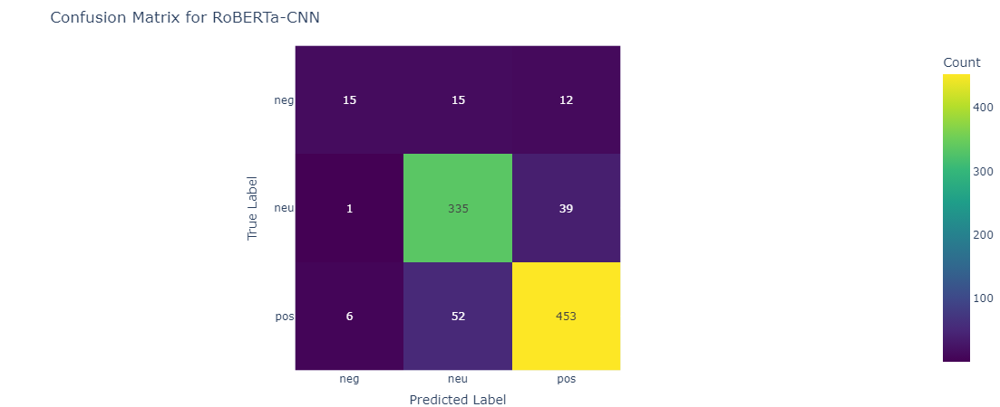

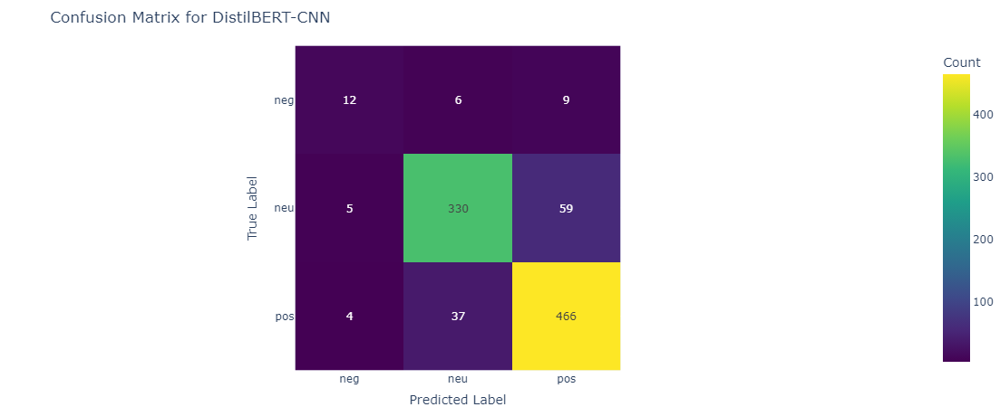

In [106]:
# Define the function to get predictions and true labels
def get_predictions(model, dataloader):
    model.eval()
    predictions = []
    true_labels = []
    
    for batch in dataloader:
        inputs, masks, labels = [t.cuda() for t in batch]
        with torch.no_grad():
            outputs = model(input_ids=inputs, attention_mask=masks)  # Directly get the output tensor
            preds = torch.argmax(outputs, dim=1).flatten()  # Apply argmax directly to the output
        
        predictions.extend(preds.cpu().numpy())
        true_labels.extend(labels.cpu().numpy())
    
    return true_labels, predictions

# Get predictions and true labels for RoBERTa-CNN model
true_labels_roberta, predictions_roberta = get_predictions(roberta_cnn_model, val_dataloader_roberta)

# Get predictions and true labels for DistilBERT-CNN model
true_labels_distilbert, predictions_distilbert = get_predictions(distilbert_cnn_model, val_dataloader_distilbert)

# Define the target names as they relate to the sentiment labels
target_names = ["neg", "neu", "pos"]

# Generate the confusion matrix
def plot_confusion_matrix(true_labels, predictions, model_name):
    conf_matrix = confusion_matrix(true_labels, predictions, labels=[0, 1, 2])
    
    # Create a heatmap for the confusion matrix
    fig = px.imshow(
        conf_matrix,
        labels=dict(x="Predicted Label", y="True Label", color="Count"),
        x=target_names,
        y=target_names,
        color_continuous_scale='Viridis',
        text_auto=True  # Display the numbers inside the squares
    )
    
    fig.update_layout(
        title=f'Confusion Matrix for {model_name}',
        xaxis_title='Predicted Label',
        yaxis_title='True Label',
        width=500,  
        height=450,  
        margin=dict(l=0, r=0, t=50, b=0)  
    )
    
    fig.update_xaxes(side="bottom", constrain='domain')  
    fig.update_yaxes(constrain='domain')  
    
    fig.show()

# Plot confusion matrix for RoBERTa-CNN
plot_confusion_matrix(true_labels_roberta, predictions_roberta, "RoBERTa-CNN")

# Plot confusion matrix for DistilBERT-CNN
plot_confusion_matrix(true_labels_distilbert, predictions_distilbert, "DistilBERT-CNN")


In [107]:
# Function to predict sentiment for new text
def predict_sentiment(model, tokenizer, text):
    model.eval()
    
    # Preprocess the text
    inputs = tokenizer([text], padding=True, truncation=True, max_length=128, return_tensors='pt')
    input_ids = inputs['input_ids'].cuda()
    attention_masks = inputs['attention_mask'].cuda()
    
    with torch.no_grad():
        outputs = model(input_ids=input_ids, attention_mask=attention_masks)
        preds = torch.argmax(outputs, dim=1).flatten()
        # Map the prediction back to original sentiment labels
        predicted_label = label_encoder.inverse_transform(preds.cpu().numpy())
        return predicted_label[0]

# Example usage for RoBERTa with CNN
example_text_roberta = "This is an amazing event with lots of excitement!"
predicted_sentiment_roberta = predict_sentiment(roberta_cnn_model, roberta_tokenizer, example_text_roberta)
print(f"RoBERTa predicted sentiment: {predicted_sentiment_roberta}")

# Example usage for DistilBERT with CNN
example_text_distilbert = "This is an amazing event with lots of excitement!"
predicted_sentiment_distilbert = predict_sentiment(distilbert_cnn_model, distilbert_tokenizer, example_text_distilbert)
print(f"DistilBERT predicted sentiment: {predicted_sentiment_distilbert}")


RoBERTa predicted sentiment: 1
DistilBERT predicted sentiment: 1


LIME Explanation for DistilBERT-CNN:


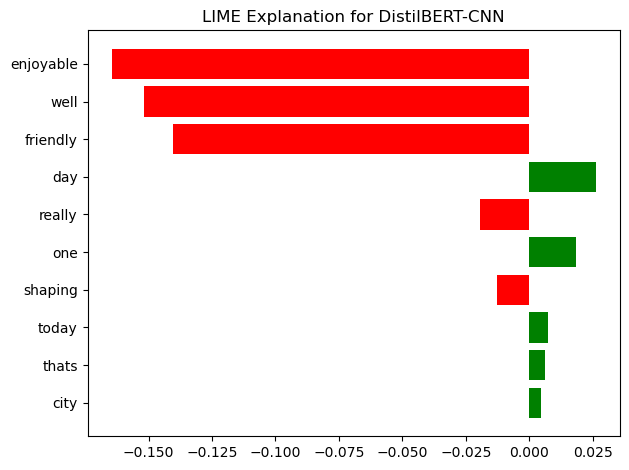

In [139]:
# Initialize LIME explainer
explainer = LimeTextExplainer(class_names=class_names)

def predict_proba_distilbert_cnn(texts):
    distilbert_cnn_model.eval()
    input_ids = [distilbert_tokenizer.encode(text, add_special_tokens=True, max_length=128, truncation=True) for text in texts]
    input_ids = pad_sequences(input_ids, maxlen=128, dtype="long", truncating="post", padding="post")
    attention_masks = [[float(i > 0) for i in seq] for seq in input_ids]

    inputs = torch.tensor(input_ids).cuda()
    masks = torch.tensor(attention_masks).cuda()

    with torch.no_grad():
        outputs = distilbert_cnn_model(inputs, masks)
        probs = torch.nn.functional.softmax(outputs, dim=1).cpu().numpy()
    
    return probs

# Define the text to explain from instance 15
instance_15_text = sentiment_df.loc[66, 'text']

# Explain the prediction for DistilBERT-CNN
exp_distilbert_cnn = explainer.explain_instance(instance_15_text, predict_proba_distilbert_cnn, num_features=10, num_samples=500)

# Display the explanation
print("LIME Explanation for DistilBERT-CNN:")
exp_distilbert_cnn.show_in_notebook()

# Plotting the explanation
fig = exp_distilbert_cnn.as_pyplot_figure(label=exp_distilbert_cnn.available_labels()[0])
plt.title('LIME Explanation for DistilBERT-CNN')
plt.tight_layout()
plt.show()


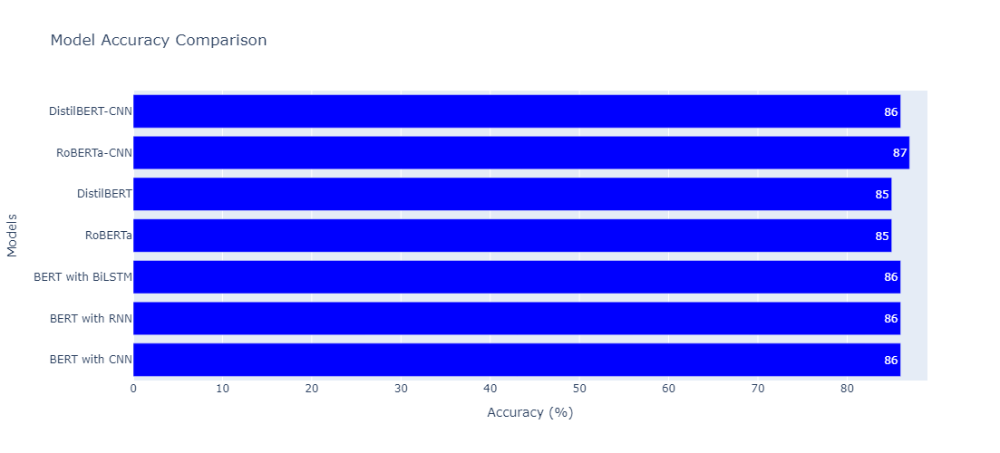

In [131]:
# Model names and corresponding accuracies
models = [
    "BERT with CNN", "BERT with RNN", "BERT with BiLSTM", "RoBERTa",
    "DistilBERT", "RoBERTa-CNN", "DistilBERT-CNN"
]
accuracies = [86, 86, 86, 85, 85, 87, 86]

# Create a bar chart
fig = go.Figure(go.Bar(
    x=accuracies,
    y=models,
    orientation='h',
    text=accuracies,
    textposition='auto',
    marker=dict(color='blue')
))

# Adjust x-axis to stop at 89%
fig.update_layout(
    title="Model Accuracy Comparison",
    xaxis=dict(
        title="Accuracy (%)",
        range=[0, 89]  # Set the range to stop at 89%
    ),
    yaxis=dict(
        title="Models"
    ),
    width=800,  # Adjust width
    height=500  # Adjust height
)

fig.show()


In [ ]:
# Inspect the label encoding
print("Original labels:", list(sentiment_df['sentiment'].unique()))
print("Encoded labels:", list(label_encoder.classes_))

In [ ]:
# Generate classification report
report_dict = classification_report(true_labels, predictions, target_names=target_names, output_dict=True)

# Convert report to DataFrame
report_df = pd.DataFrame(report_dict).transpose()
report_df = report_df.round(2)  # Round to 2 decimal places for better readability


In [ ]:
report_df

In [ ]:
import plotly.graph_objects as go

# Extract precision, recall, and f1-score
precision = report_df['precision'][:-3]  # Exclude the last three rows (accuracy, macro avg, weighted avg)
recall = report_df['recall'][:-3]
f1_score = report_df['f1-score'][:-3]
support = report_df['support'][:-3]

# Create a bar chart
fig = go.Figure()

fig.add_trace(go.Bar(
    x=report_df.index[:-3],  # Class labels
    y=precision,
    name='Precision',
    marker_color='indianred'
))

fig.add_trace(go.Bar(
    x=report_df.index[:-3],
    y=recall,
    name='Recall',
    marker_color='lightsalmon'
))

fig.add_trace(go.Bar(
    x=report_df.index[:-3],
    y=f1_score,
    name='F1-Score',
    marker_color='mediumseagreen'
))

fig.update_layout(
    title='Classification Report',
    xaxis=dict(title='Class'),
    yaxis=dict(title='Score'),
    barmode='group',
    bargap=0.15,
    bargroupgap=0.1,
    template='plotly_white'
)

fig.show()


In [ ]:
import plotly.express as px

# Ensure target names are strings for plotly
target_names = [str(cls) for cls in label_encoder.classes_]

# Generate the confusion matrix
conf_matrix = confusion_matrix(true_labels, predictions)

# Create a heatmap for the confusion matrix
fig = px.imshow(
    conf_matrix,
    labels=dict(x="Predicted Label", y="True Label", color="Count"),
    x=target_names,
    y=target_names,
    color_continuous_scale='Viridis'
)

fig.update_layout(
    title='Confusion Matrix',
    xaxis_title='Predicted Label',
    yaxis_title='True Label'
)

fig.show()


In [ ]:
# Check original dataset size
original_dataset_size = len(sentiment_df)
print(f"Original dataset size: {original_dataset_size}")

# Check sizes after train-test split
train_size = len(train_inputs)
val_size = len(val_inputs)
total_split_size = train_size + val_size
print(f"Training set size: {train_size}")
print(f"Validation set size: {val_size}")
print(f"Total size after train-test split: {total_split_size}")

# Verify the confusion matrix total
conf_matrix = confusion_matrix(true_labels, predictions)
total_cm_size = np.sum(conf_matrix)
print(f"Total size in confusion matrix: {total_cm_size}")

# Compare with the number of rows in the dataset
assert total_cm_size == val_size, "Mismatch in validation set size and confusion matrix size"


In [ ]:
# Count the number of each sentiment
sentiment_counts = sentiment_df['sentiment'].value_counts().sort_index()
print(f"Sentiment counts:\n{sentiment_counts}")

In [ ]:
import plotly.graph_objects as go
import pandas as pd

# Create a DataFrame for plotting
sentiment_plot_df = pd.DataFrame({
    'Sentiment': ['Negative', 'Neutral', 'Positive'],
    'Count': [sentiment_counts.get(-1, 0), sentiment_counts.get(0, 0), sentiment_counts.get(1, 0)]
})

# Plot the sentiment counts using Plotly with adjusted width and bar gap
fig = go.Figure(data=[
    go.Bar(name='Sentiment', x=sentiment_plot_df['Sentiment'], y=sentiment_plot_df['Count'])
])

fig.update_layout(
    title='Sentiment Counts',
    xaxis_title='Sentiment',
    yaxis_title='Number of Posts',
    bargap=0.5,   # Increase the bargap to create more space between bars
    width=800,    # Set the width of the entire chart
    height=600    # Optionally, set the height of the entire chart
)

fig.show()


# Exploratory Data Analysis

In [ ]:
import plotly.graph_objects as go
import pandas as pd

# Count the number of each sentiment
sentiment_counts = sentiment_df['sentiment'].value_counts().sort_index()

# Calculate the percentages
total_count = sentiment_counts.sum()
sentiment_percentages = (sentiment_counts / total_count) * 100

# Create a DataFrame for the table
sentiment_table_df = pd.DataFrame({
    'Sentiment': ['Negative', 'Neutral', 'Positive'],
    'Count': [sentiment_counts.get(-1, 0), sentiment_counts.get(0, 0), sentiment_counts.get(1, 0)],
    'Percentage': [sentiment_percentages.get(-1, 0), sentiment_percentages.get(0, 0), sentiment_percentages.get(1, 0)]
})

# Create a table for sentiment counts and percentages
fig_table = go.Figure(data=[
    go.Table(
        header=dict(
            values=['Sentiment', 'Count', 'Percentage'],
            fill_color='paleturquoise',
            align='left'
        ),
        cells=dict(
            values=[sentiment_table_df['Sentiment'], sentiment_table_df['Count'], sentiment_table_df['Percentage'].round(2)],
            fill_color='lavender',
            align='left'
        )
    )
])

# Update layout for the table
fig_table.update_layout(
    title='Sentiment Counts and Percentages',
    width=500,  # Set the width of the table
    height=300  # Optionally, set the height of the table
)


fig_table.show()


In [ ]:
import torch

torch.cuda.empty_cache()


In [ ]:
import numpy as np

def predict_proba(texts, batch_size=8):
    model.eval()
    all_probs = []
    for i in range(0, len(texts), batch_size):
        batch_texts = texts[i:i+batch_size]
        inputs = [tokenizer.encode(text, add_special_tokens=True, max_length=128) for text in batch_texts]
        inputs = pad_sequences(inputs, maxlen=128, dtype="long", truncating="post", padding="post")
        attention_masks = [[float(i > 0) for i in seq] for seq in inputs]
        
        inputs = torch.tensor(inputs).cuda()
        masks = torch.tensor(attention_masks).cuda()
        
        with torch.no_grad():
            outputs = model(inputs, masks)
            probs = nn.Softmax(dim=1)(outputs).cpu().numpy()
            all_probs.extend(probs)
    
    return np.array(all_probs)


In [ ]:
import lime
from lime.lime_text import LimeTextExplainer

# Create a LIME text explainer
explainer = LimeTextExplainer(class_names=label_encoder.classes_)

# Select a subset of your dataset for explanation
subset_indices = [15]  # Replace with the indices of the rows you want to explain
subset_texts = sentiment_df['text'].iloc[subset_indices].tolist()

# Clear GPU memory
torch.cuda.empty_cache()

# Generate explanations
for idx, text in enumerate(subset_texts):
    exp = explainer.explain_instance(text, lambda x: predict_proba(x, batch_size=4), num_features=10)
    print(f"Explanation for index {subset_indices[idx]}:")
    exp.show_in_notebook(text=True)


In [ ]:
import lime
from lime.lime_text import LimeTextExplainer

# Create a LIME text explainer
explainer = LimeTextExplainer(class_names=label_encoder.classes_)

# Select a subset of your dataset for explanation
subset_indices = [25]  # Replace with the indices of the rows you want to explain
subset_texts = sentiment_df['text'].iloc[subset_indices].tolist()

# Clear GPU memory
torch.cuda.empty_cache()

# Generate explanations
for idx, text in enumerate(subset_texts):
    exp = explainer.explain_instance(text, lambda x: predict_proba(x, batch_size=4), num_features=10)
    print(f"Explanation for index {subset_indices[idx]}:")
    exp.show_in_notebook(text=True)


In [ ]:
import lime
from lime.lime_text import LimeTextExplainer

# Create a LIME text explainer
explainer = LimeTextExplainer(class_names=label_encoder.classes_)

# Select a subset of your dataset for explanation
subset_indices = [3991]  # Replace with the indices of the rows you want to explain
subset_texts = sentiment_df['text'].iloc[subset_indices].tolist()

# Clear GPU memory
torch.cuda.empty_cache()

# Generate explanations
for idx, text in enumerate(subset_texts):
    exp = explainer.explain_instance(text, lambda x: predict_proba(x, batch_size=4), num_features=10)
    print(f"Explanation for index {subset_indices[idx]}:")
    exp.show_in_notebook(text=True)


In [ ]:
import lime
from lime.lime_text import LimeTextExplainer
import torch
import matplotlib.pyplot as plt

# Create a LIME text explainer
explainer = LimeTextExplainer(class_names=label_encoder.classes_)

# Select a subset of your dataset for explanation
subset_indices = [3991]  # Replace with the indices of the rows you want to explain
subset_texts = sentiment_df['text'].iloc[subset_indices].tolist()

# Clear GPU memory
torch.cuda.empty_cache()

# Generate explanations and display probability instance chart
for idx, text in enumerate(subset_texts):
    exp = explainer.explain_instance(text, lambda x: predict_proba(x, batch_size=4), num_features=10)
    print(f"Explanation for index {subset_indices[idx]}:")
    
    # Display the explanation in a notebook
    exp.show_in_notebook(text=True)
    
    # Get the explanation as a matplotlib figure and display it
    fig = exp.as_pyplot_figure()
    plt.title(f'LIME Explanation for index {subset_indices[idx]}')
    plt.show()
    
    # Save the figure if needed
    fig.savefig(f'lime_explanation_{subset_indices[idx]}.png')


In [102]:
import plotly.graph_objects as go
import pandas as pd

# Create a DataFrame for plotting
sentiment_plot_df = pd.DataFrame({
    'Sentiment': ['Negative', 'Neutral', 'Positive'],
    'Count': [sentiment_counts.get(-1, 0), sentiment_counts.get(0, 0), sentiment_counts.get(1, 0)]
})

# Plot the sentiment counts using Plotly with adjusted width and bar gap
fig = go.Figure(data=[
    go.Bar(name='Sentiment', x=sentiment_plot_df['Sentiment'], y=sentiment_plot_df['Count'])
])

# Update layout for bar gap and chart width
fig.update_layout(
    title='Sentiment Counts',
    xaxis_title='Sentiment',
    yaxis_title='Number of Posts',
    bargap=0.5,   
    width=800,   
    height=600  
)

# Show the plot
fig.show()


NameError: name 'sentiment_counts' is not defined

## Conclusion and Recommendations
The notebook concludes with key findings from the sentiment and topic analysis. Recommendations are provided on how the Bradford City of Culture 2025 team can use these insights to engage with the community more effectively and address any areas of concern.
